<a href="https://colab.research.google.com/github/ali-talebi/proposal_master/blob/main/Part3_Simulation_master_project_alitalebi.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [5]:
import pandas as pd
import numpy  as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import PolynomialFeatures

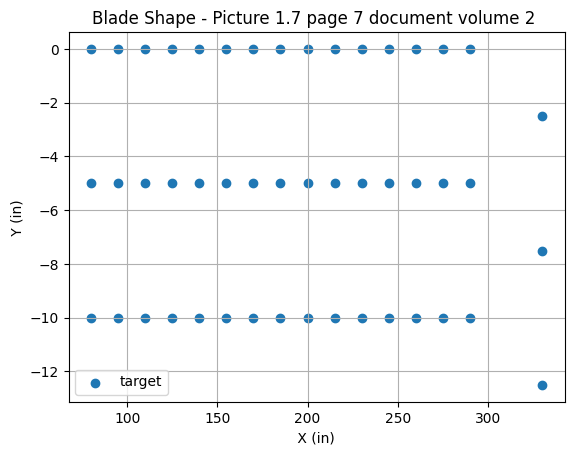

In [6]:
points = []
start_x = 65
start_y = [0 , -5 , -10.0 ]
for i in range(15) :
  start_x +=  15

  for j in range(3) :
    points.append([start_x , start_y[j] , 0 ] )

points.append([330 , -2.5 , 0 ])
points.append([330 , -7.5 , 0 ])
points.append([330 , -12.5 , 0 ])
total_points = np.array(points)
plt.scatter(total_points[ : ,  0 ] , total_points[ : , 1 ] , label = "target" )
plt.legend()
plt.title("Blade Shape - Picture 1.7 page 7 document volume 2 ")
plt.xlabel(" X (in) ")
plt.ylabel(" Y (in) ")
plt.grid()
plt.show()

In [7]:
dict_28_24_blade_1 = {"r/R"           :[0.2001 , 0.2499 ,0.2998 , 0.3498 , 0.3913 , 0.4496 , 0.4997 , 0.5387 , 0.5996 , 0.6498 , 0.6998 , 0.7500 , 0.8001 , 0.8497 , 0.9102 , 0.9734 ] ,
              "Delta XMean (in.)"     : [-0.0045 , -0.0011 , -0.0281 , -0.0177 , -0.0113 , -0.0186 , -0.0133 , -0.0232 , -0.0338 , -0.0307 , -0.0633 , -0.0773 , -0.0811 , -0.1920 , -0.2623 , -0.2629 ] ,
              "Delta XStd (in.)"      : [0.0010 , 0.0009 , 0.0011 , 0.0011 , 0.0016 , 0.0019 , 0.0022 , 0.0020 , 0.0019 , 0.0023 , 0.0021 , 0.0021 , 0.0021 , 0.0022 , 0.0023 , 0.0026 ] ,
              "Delta YMean (in.)"     : [-0.0132 , -0.0225 , -0.0483 , -0.0939 , -0.1256 , -0.1809 , -0.2209 , -0.2510 , -0.3087 , -0.3422 , -0.3874 , -0.4184 , -0.5123 , -0.5296 , -0.5487 , -0.5354 ] ,
              "Delta YStd (in.)"      : [0.0007 , 0.0013 , 0.0028 , 0.0046 , 0.0066 , 0.0088 , 0.0111 , 0.0126 , 0.0150 , 0.0176 , 0.0201 , 0.0229 , 0.0258 , 0.0284 , 0.0313 , 0.0350 ]  ,
              "Delta ZMean (in.)"     : [-0.0050 , -0.0010 , -0.0251  ,-0.0442 , -0.0622 , -0.1306 , -0.2121 , -0.3077 , -0.4860 , -0.7122 , -0.9213 , -1.1503 , -1.3874 , -1.7166 , -2.1240 , -2.5162 ] ,
              "Delta ZStd (in.)"      : [0.0023 , 0.0046 , 0.0089 , 0.0145 , 0.0211 , 0.0267 , 0.0347 , 0.0404 , 0.0480 , 0.0540 , 0.0607 , 0.0666 , 0.0718 , 0.0784 , 0.0857 , 0.0943 ] ,
              "Delta TwistMean (deg)" : [-0.0685 , 0.2730 , 0.0049  , 0.0060 , 0.0002 , -0.1528 , -0.1632 , -0.3044 , -0.2646 , -0.4566 , -0.4899 , -0.3256 , 0.0164 , -0.3486 , -0.6888 , -0.6556 ] ,
              "Delta TwistStd (deg)"  : [0.0233 , 0.0392 , 0.0515 , 0.0431 , 0.0476 , 0.0461 , 0.0479 , 0.0528 , 0.0516 , 0.0503 , 0.0581 , 0.0443 , 0.0504 , 0.0462  , 0.0444 , 0.0510]
}


table_28_24_blade_1 = pd.DataFrame(dict_28_24_blade_1)

In [8]:
table_28_24_blade_1

,r/R,Delta XMean (in.),Delta XStd (in.),Delta YMean (in.),Delta YStd (in.),Delta ZMean (in.),Delta ZStd (in.),Delta TwistMean (deg),Delta TwistStd (deg)
0,0.2001,-0.0045,0.0010,-0.0132,0.0007,-0.0050,0.0023,-0.0685,0.0233
1,0.2499,-0.0011,0.0009,-0.0225,0.0013,-0.0010,0.0046,0.2730,0.0392
2,0.2998,-0.0281,0.0011,-0.0483,0.0028,-0.0251,0.0089,0.0049,0.0515
3,0.3498,-0.0177,0.0011,-0.0939,0.0046,-0.0442,0.0145,0.0060,0.0431
4,0.3913,-0.0113,0.0016,-0.1256,0.0066,-0.0622,0.0211,0.0002,0.0476
5,0.4496,-0.0186,0.0019,-0.1809,0.0088,-0.1306,0.0267,-0.1528,0.0461
6,0.4997,-0.0133,0.0022,-0.2209,0.0111,-0.2121,0.0347,-0.1632,0.0479
7,0.5387,-0.0232,0.0020,-0.2510,0.0126,-0.3077,0.0404,-0.3044,0.0528
8,0.5996,-0.0338,0.0019,-0.3087,0.0150,-0.4860,0.0480,-0.2646,0.0516
9,0.6498,-0.0307,0.0023,-0.3422,0.0176,-0.7122,0.0540,-0.4566,0.0503


Mse is :  0.005151678735635903


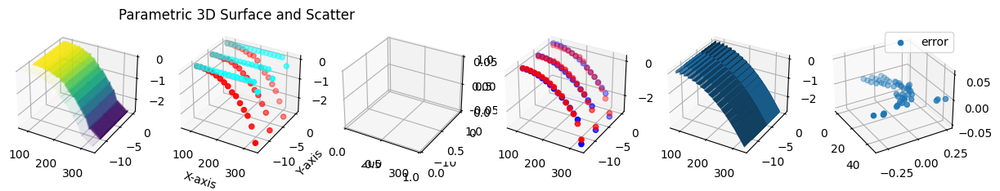

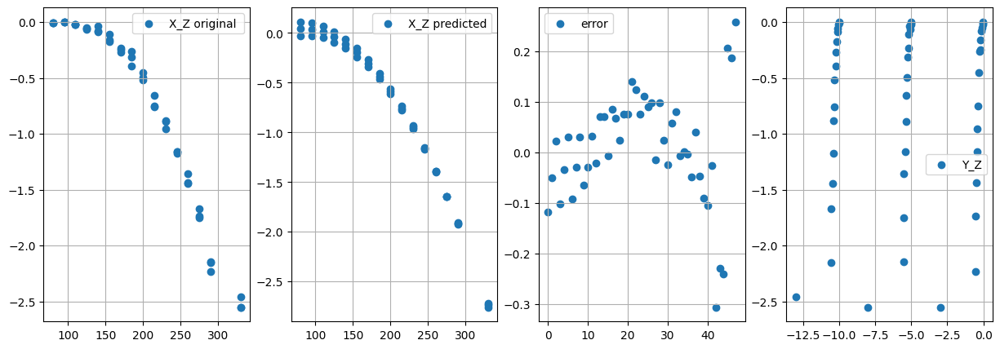

//////// ******************** ///////
Mse is :  0.005781531483293495


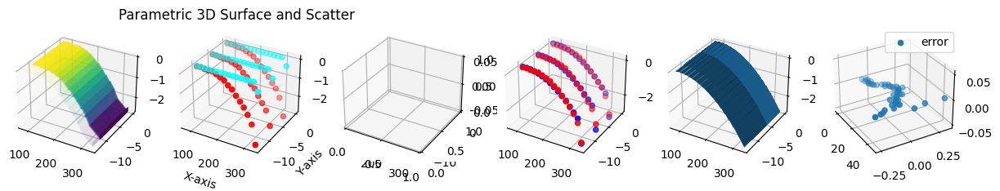

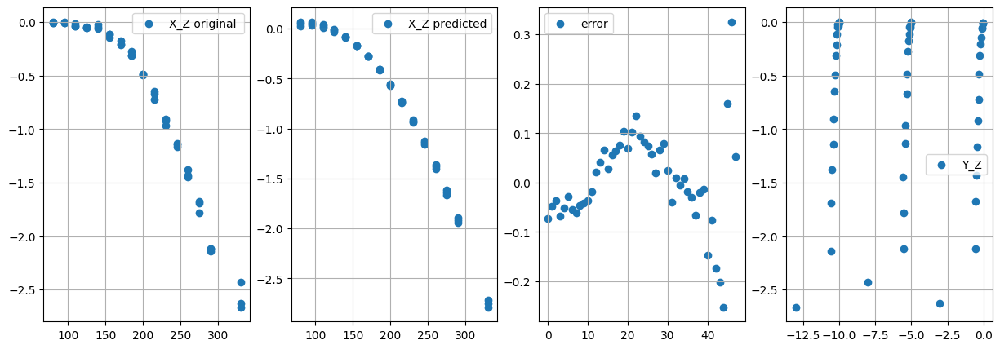

//////// ******************** ///////
Mse is :  0.004389350546467282


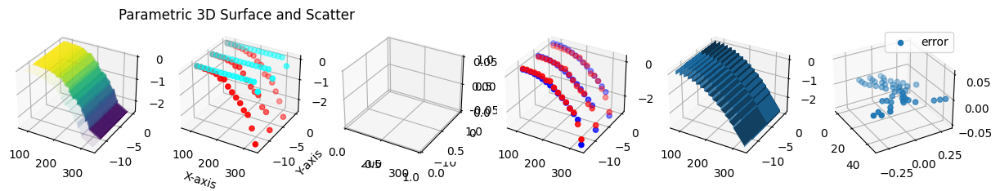

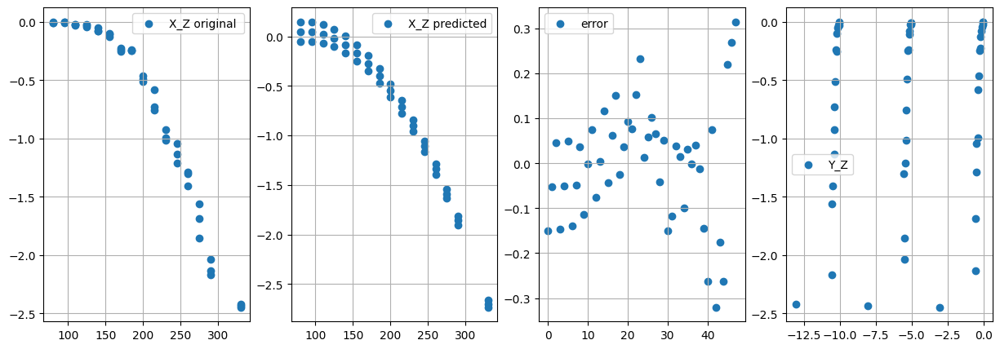

//////// ******************** ///////
Mse is :  0.011626284170476663


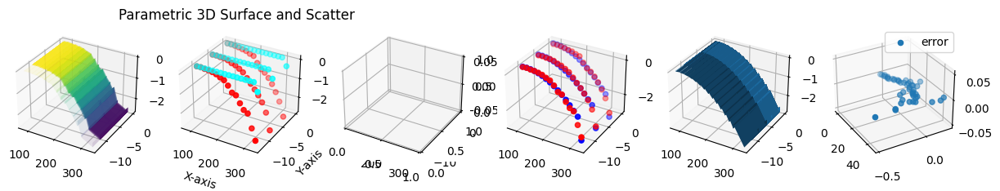

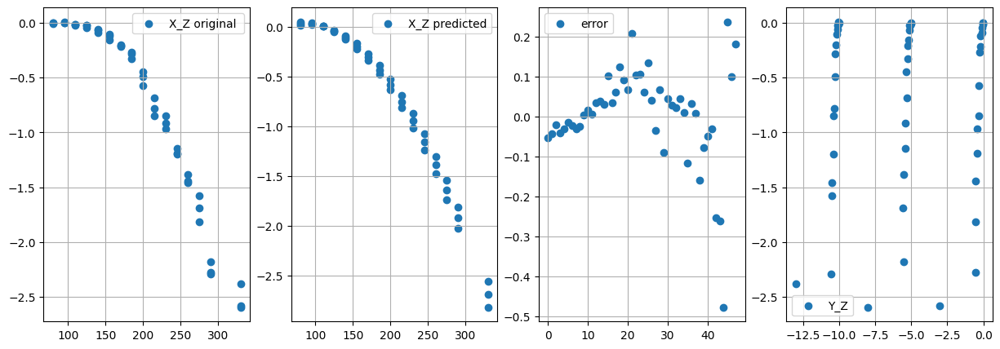

//////// ******************** ///////
Mse is :  0.024234698773730634


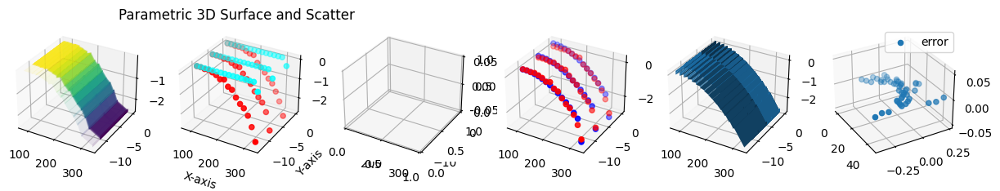

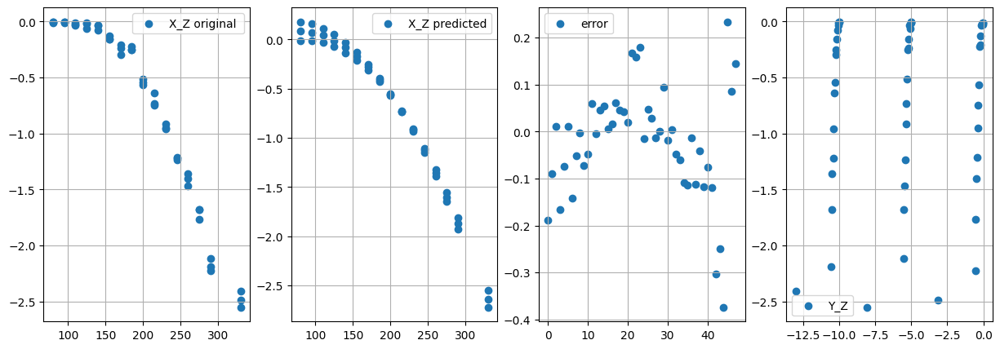

//////// ******************** ///////
Mse is :  0.010845580297497265


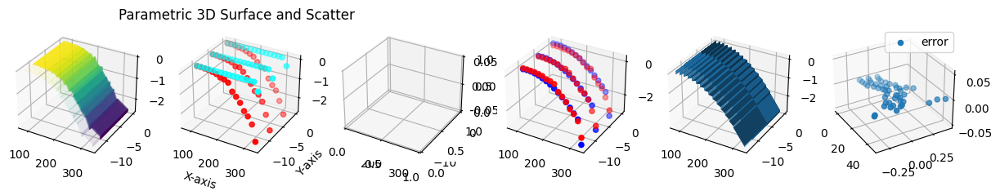

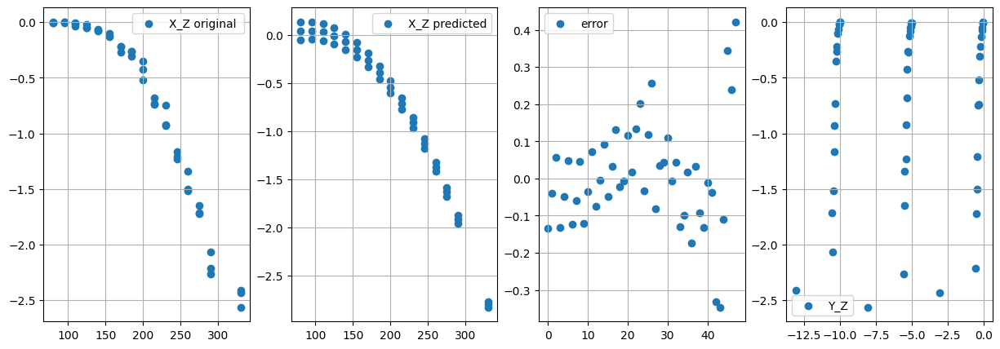

//////// ******************** ///////
Mse is :  0.01632774024243697


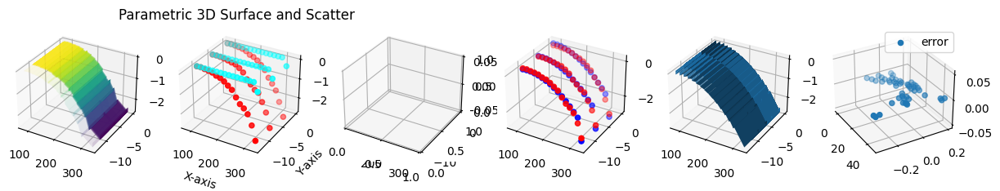

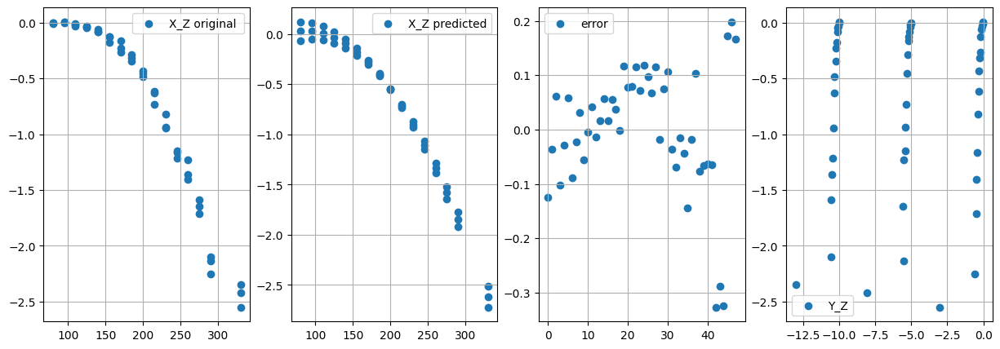

//////// ******************** ///////
Mse is :  0.02595200502758342


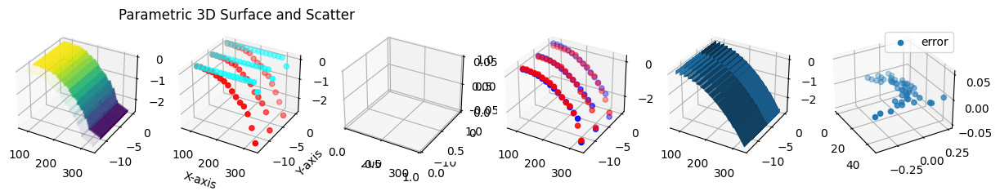

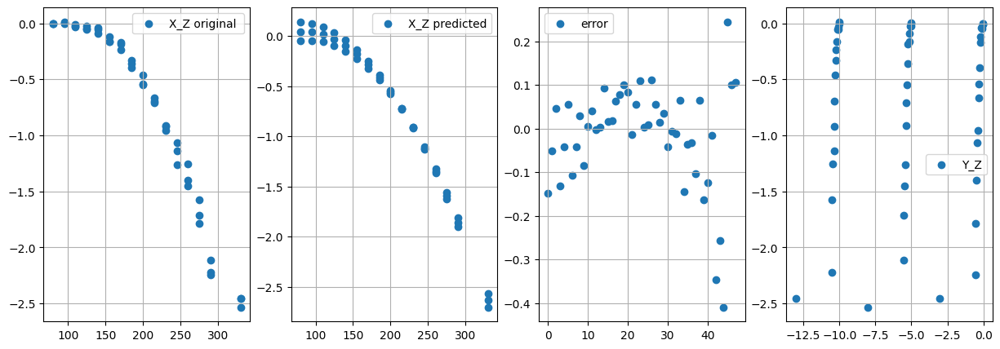

//////// ******************** ///////
Mse is :  0.012846405085148565


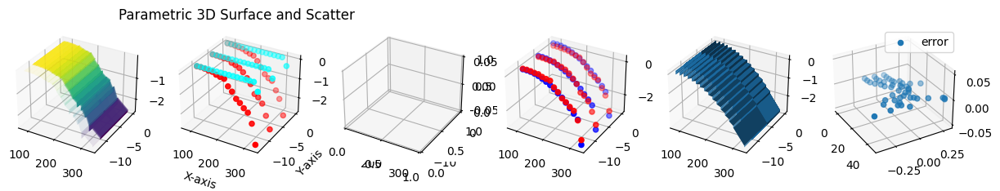

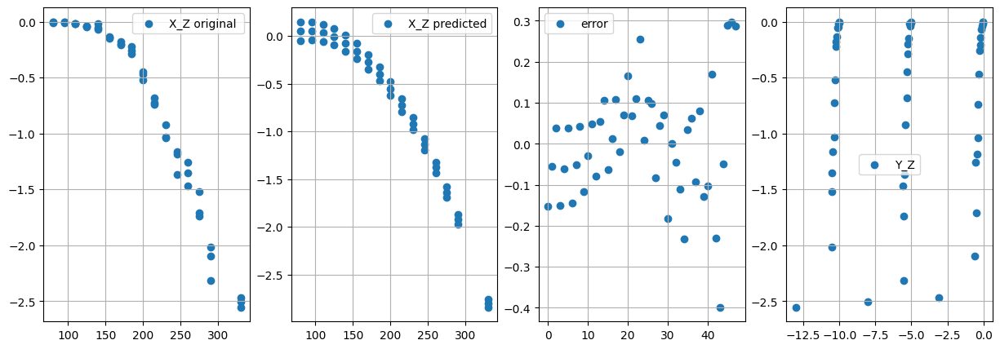

//////// ******************** ///////
Mse is :  0.0189189667292417


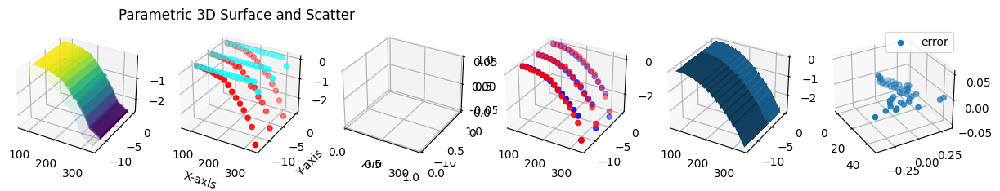

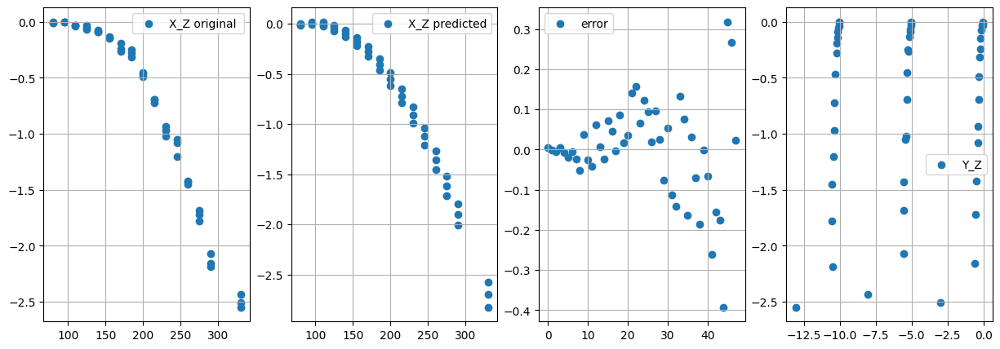

//////// ******************** ///////
Mse is :  0.012091325451008975


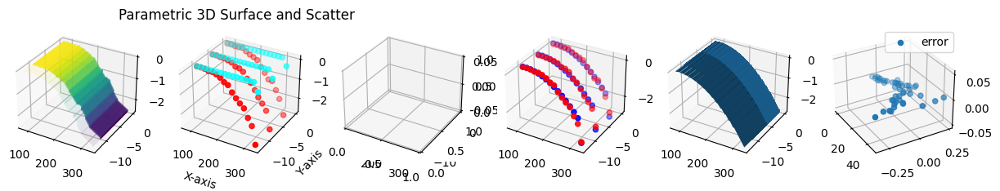

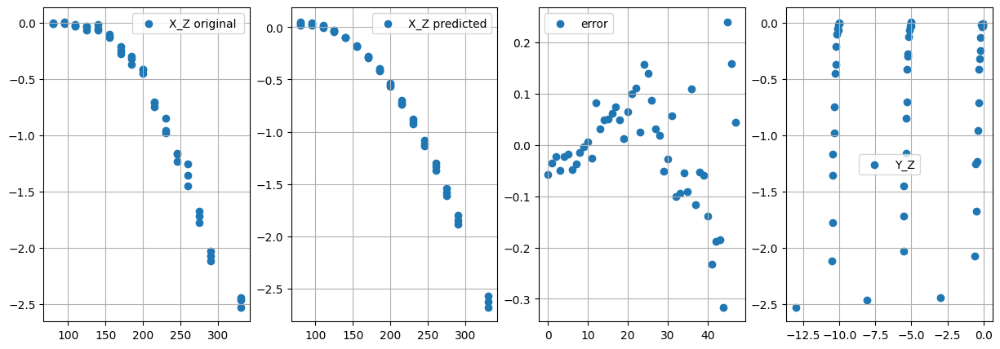

//////// ******************** ///////
Mse is :  0.00926383125149287


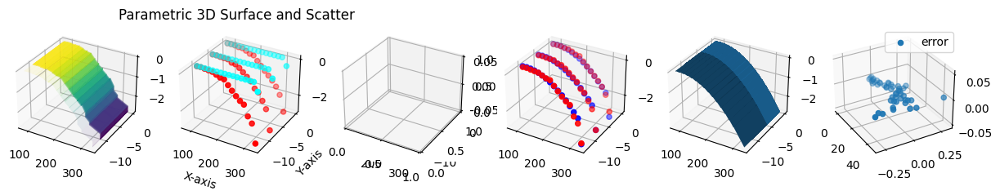

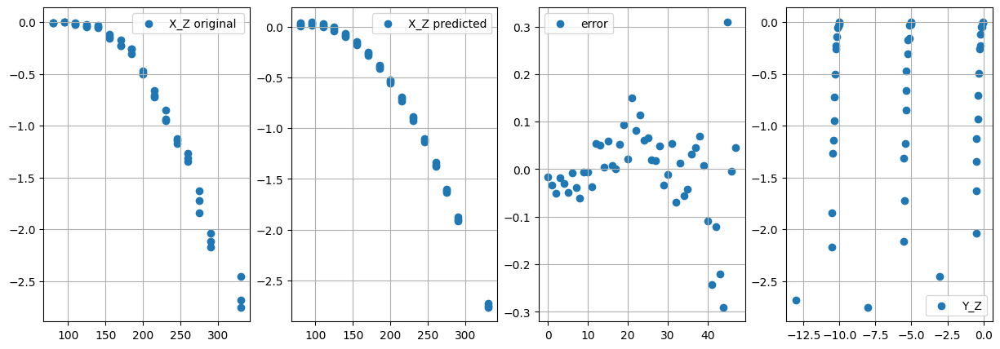

//////// ******************** ///////
Mse is :  0.03543292495342016


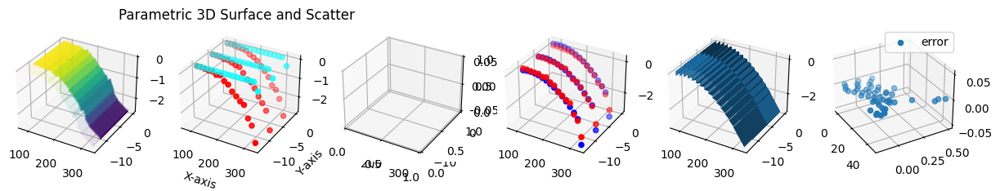

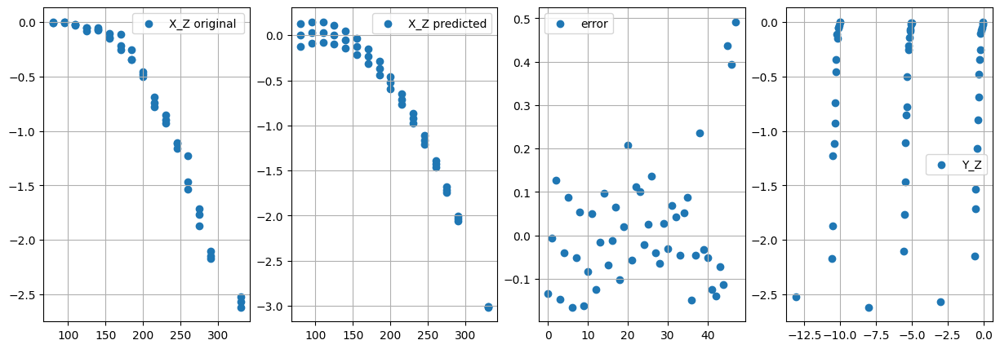

//////// ******************** ///////
Mse is :  0.008864570469544085


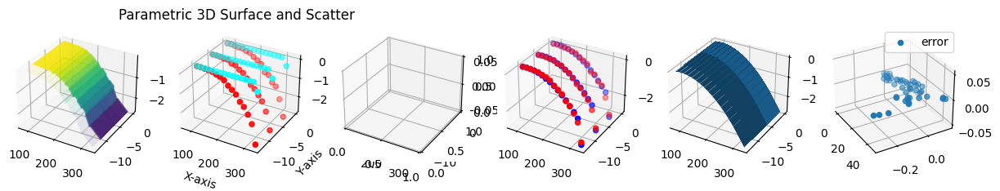

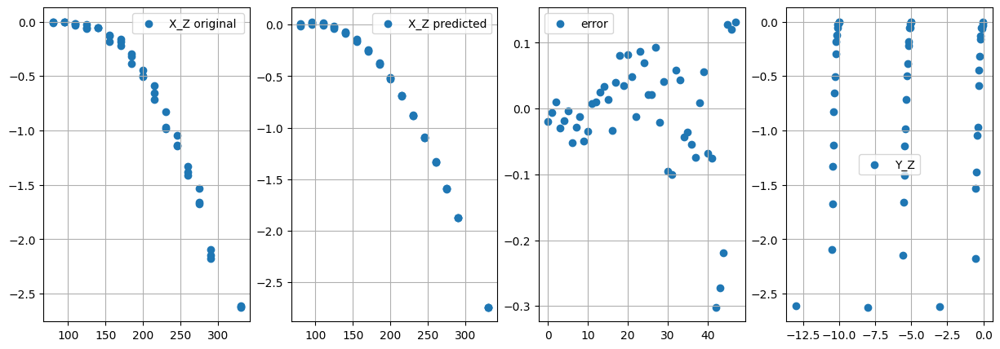

//////// ******************** ///////
Mse is :  0.006096647455042454


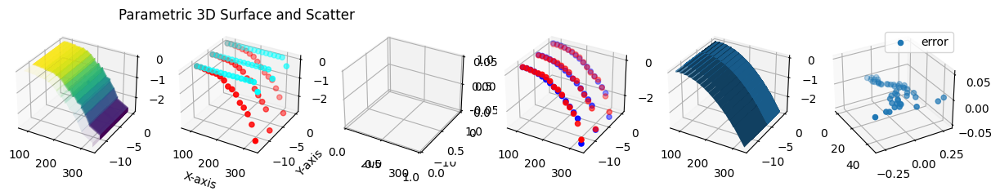

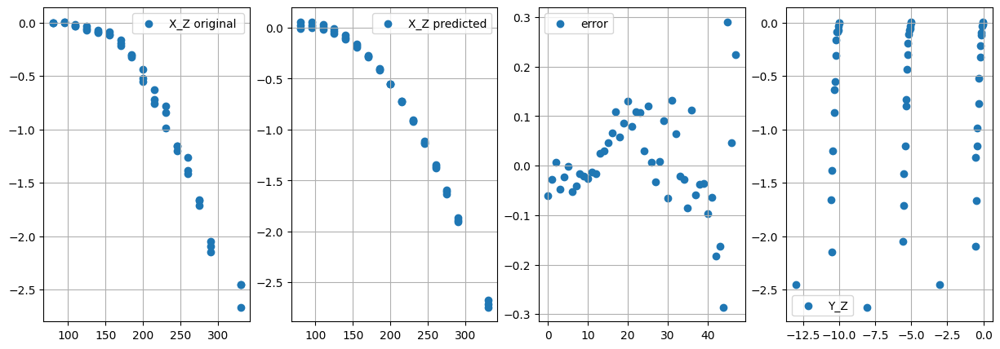

//////// ******************** ///////
Mse is :  0.021309238752626667


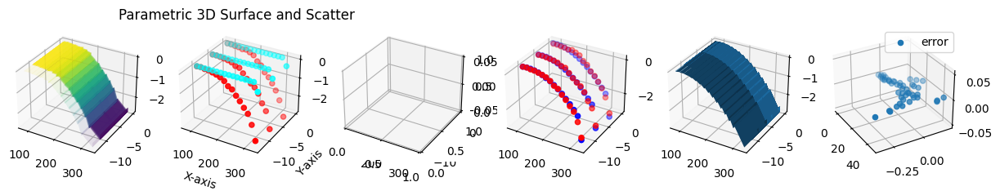

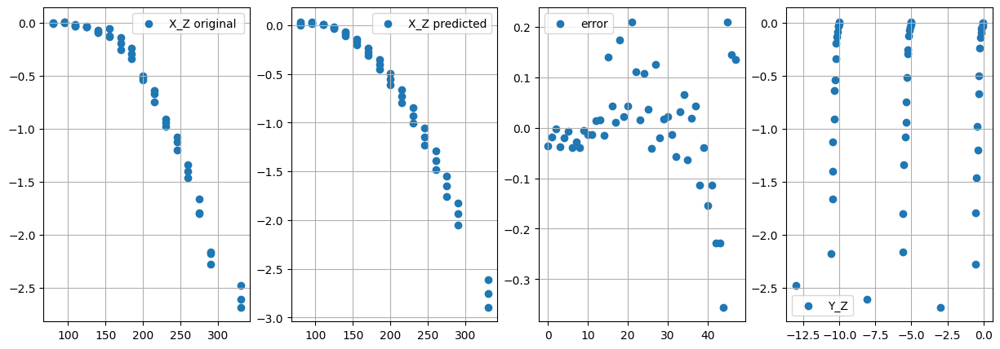

//////// ******************** ///////
Mse is :  0.004504419592474313


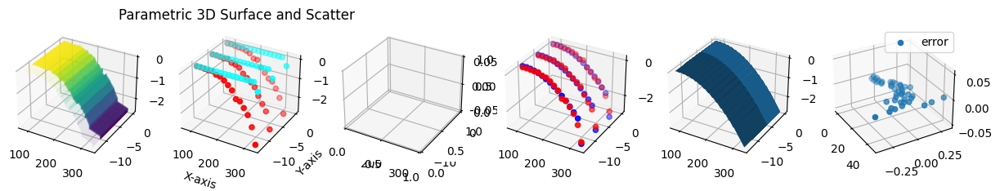

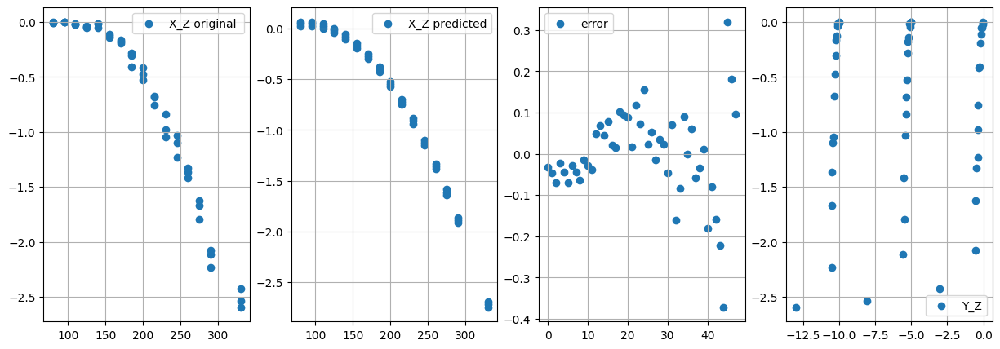

//////// ******************** ///////
Mse is :  0.004890527661361132


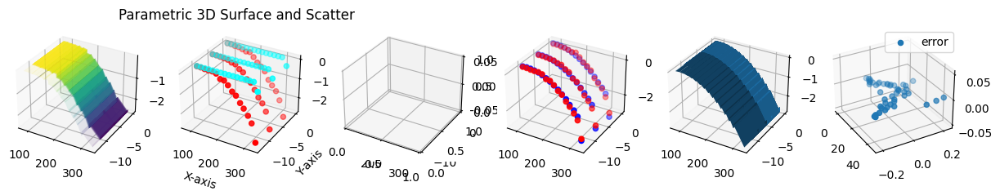

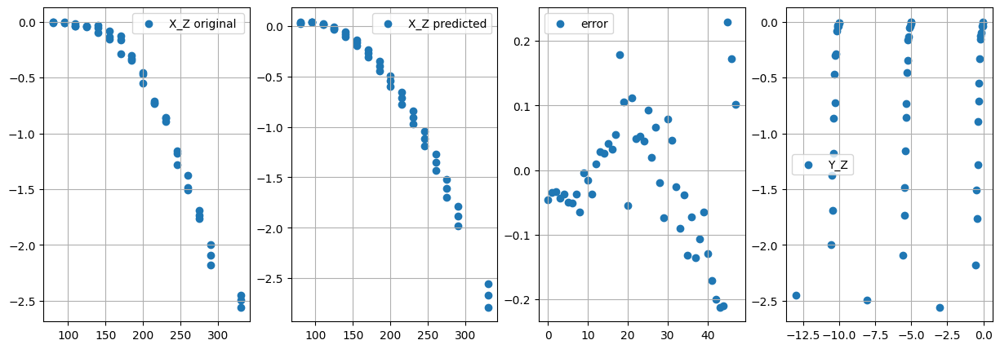

//////// ******************** ///////
Mse is :  0.015185140489407742


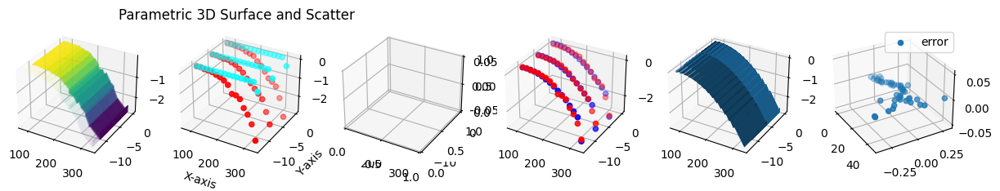

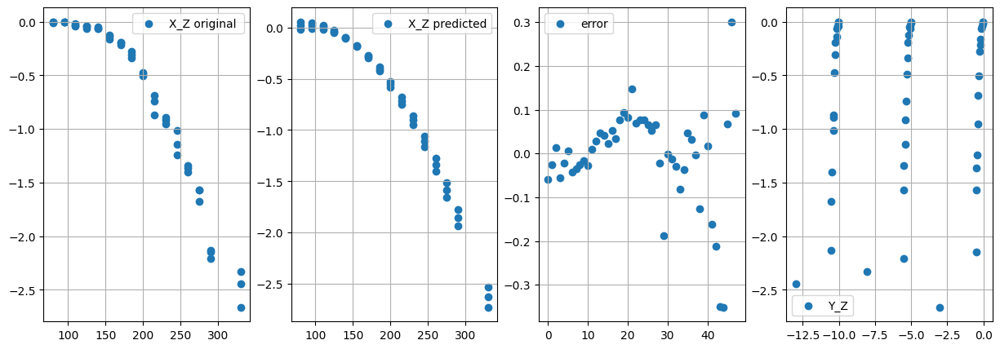

//////// ******************** ///////
Mse is :  0.03185571680939588


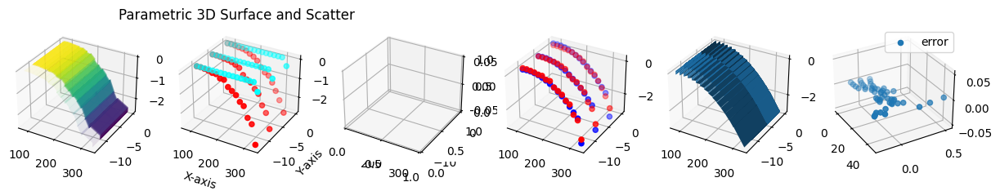

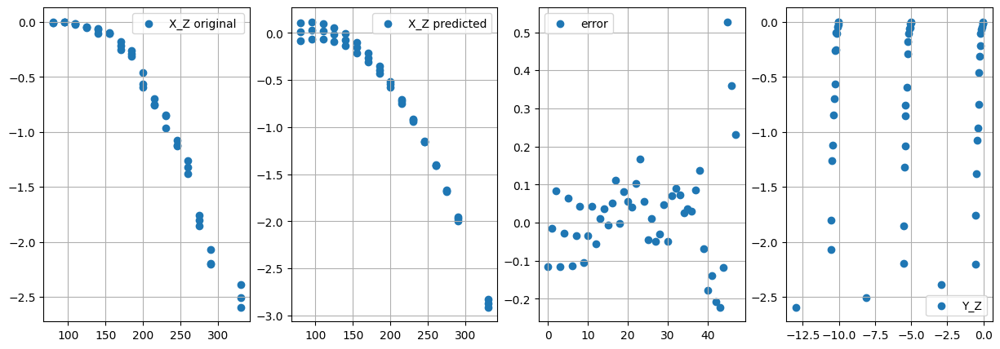

//////// ******************** ///////
Mse is :  0.026535361824077258


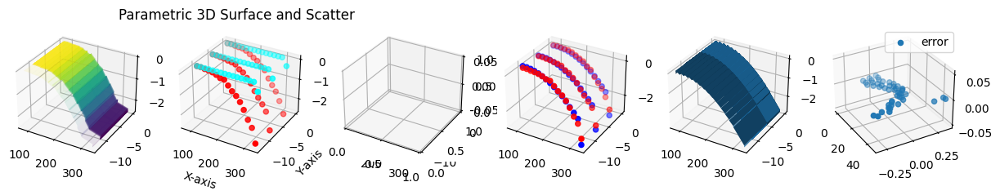

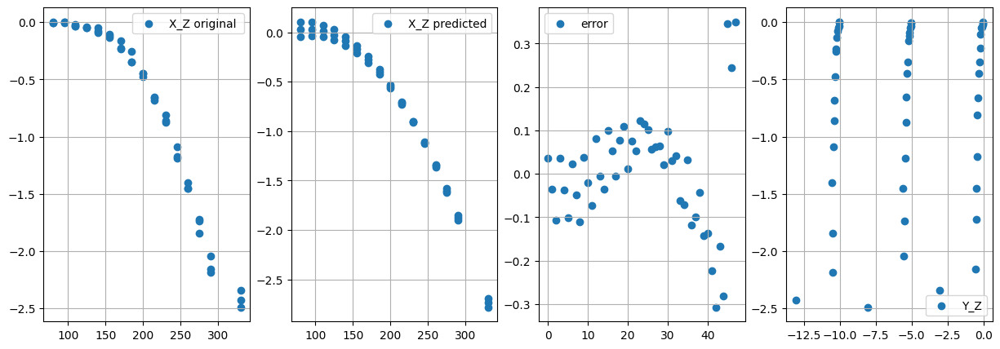

//////// ******************** ///////
Mse is :  0.01881598121587241


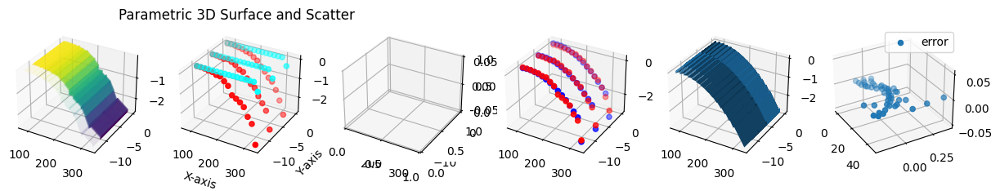

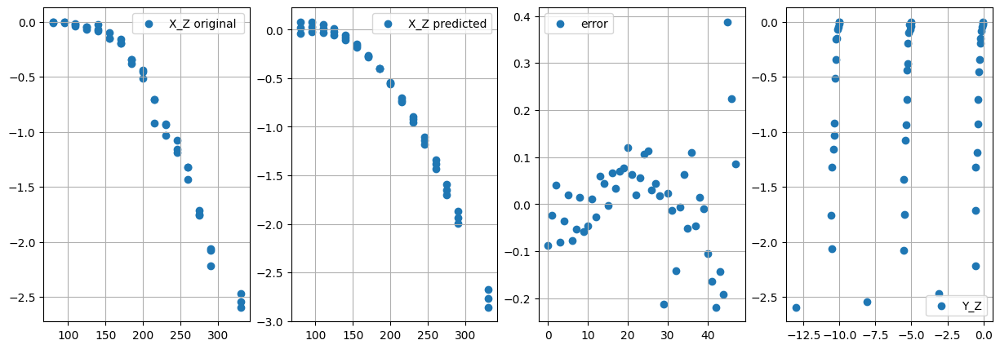

//////// ******************** ///////
Mse is :  0.002854074534721038


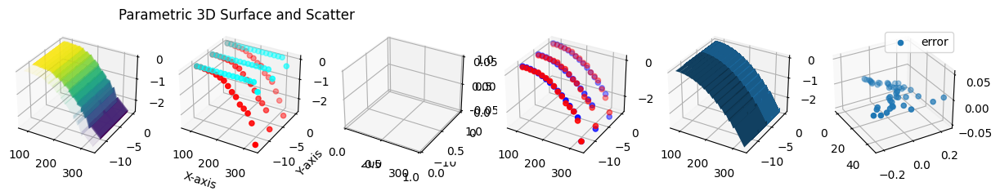

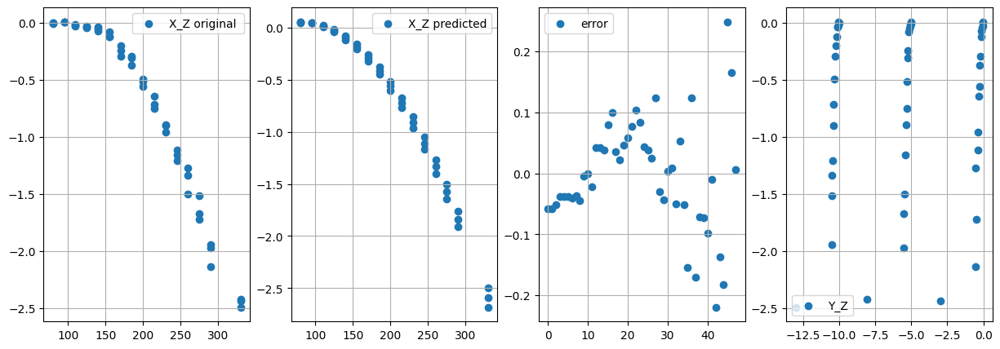

//////// ******************** ///////
Mse is :  0.03258588641518837


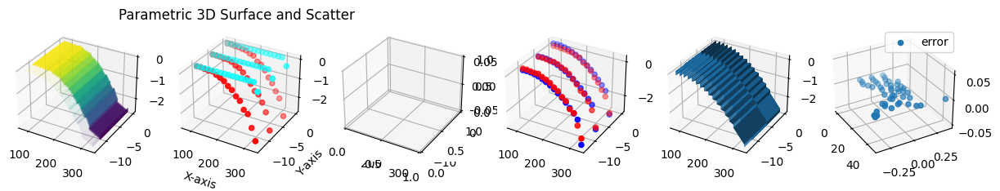

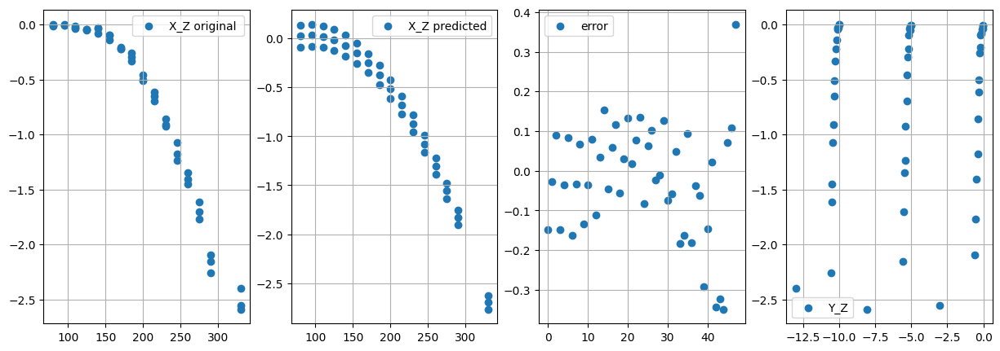

//////// ******************** ///////
Mse is :  0.0035042662258307215


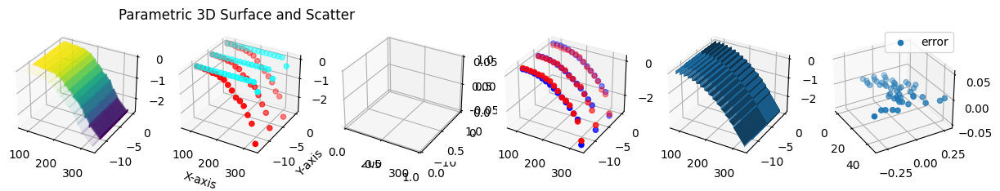

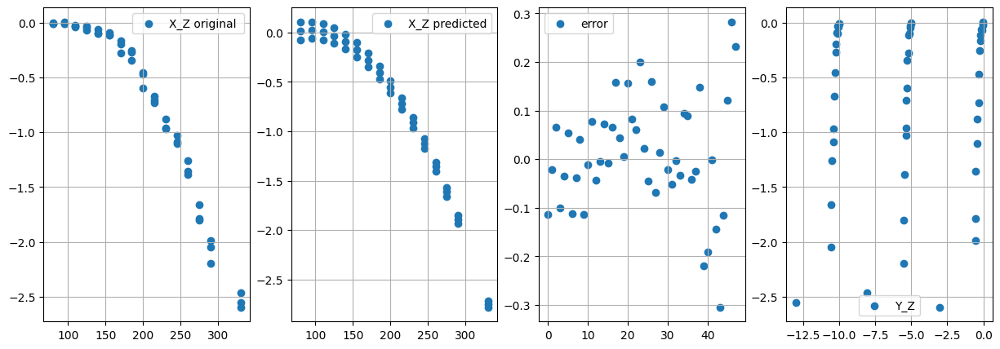

//////// ******************** ///////
Mse is :  0.016127414200070512


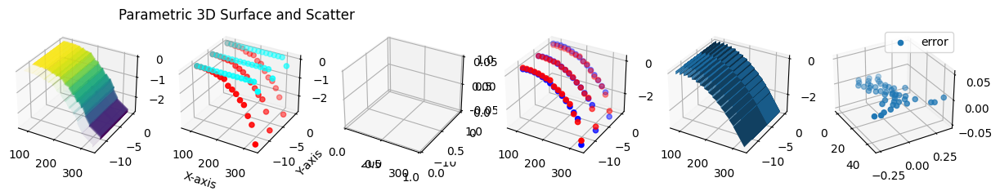

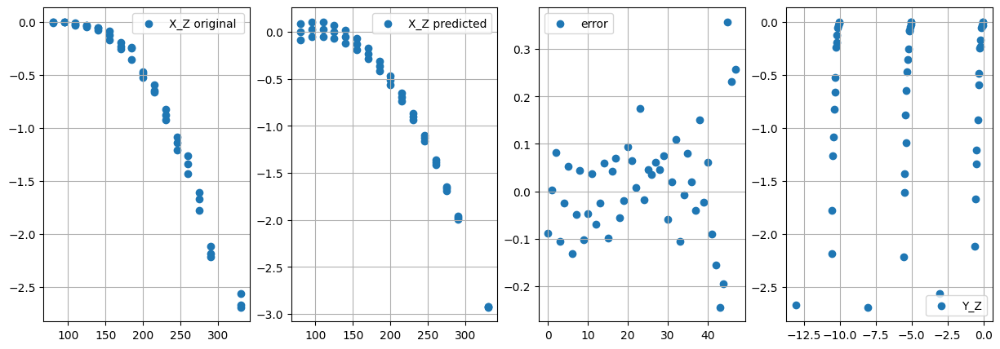

//////// ******************** ///////
Mse is :  0.023094438456401318


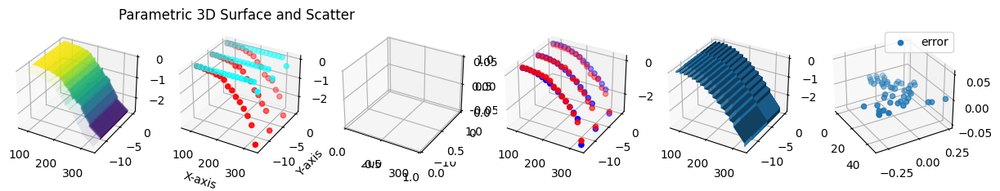

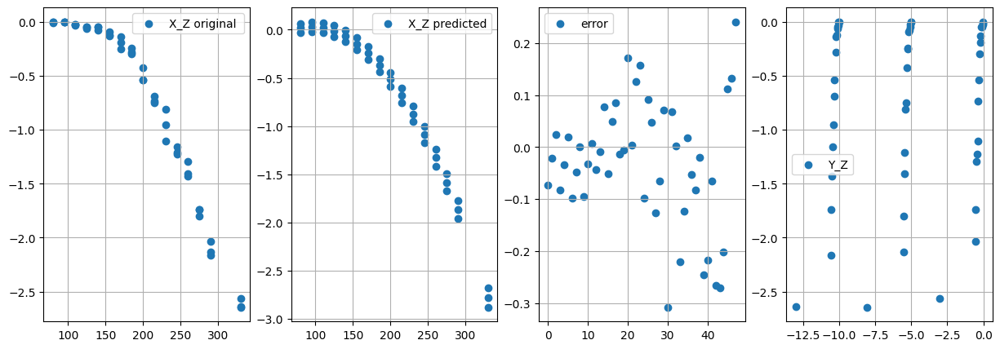

//////// ******************** ///////
Mse is :  0.019404260379858568


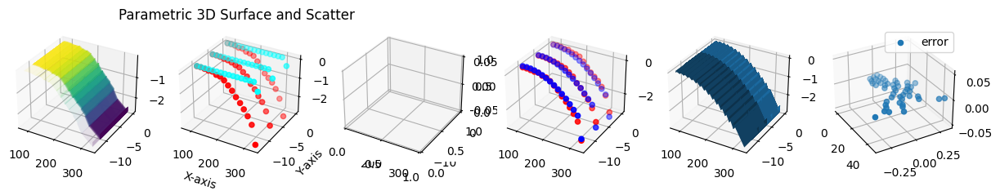

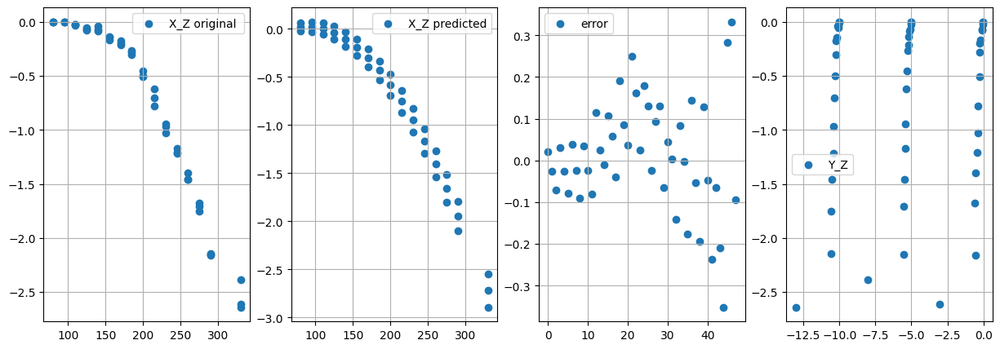

//////// ******************** ///////
Mse is :  0.024894604728394


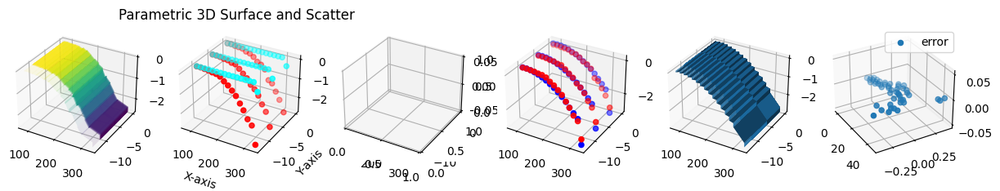

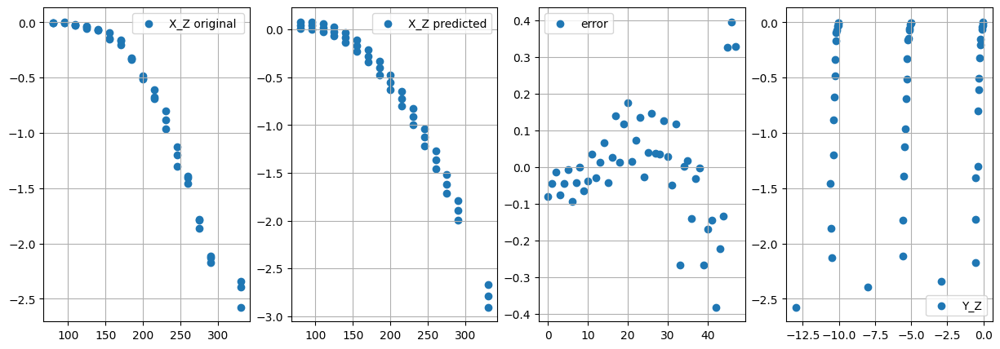

//////// ******************** ///////
Mse is :  0.017389032809105472


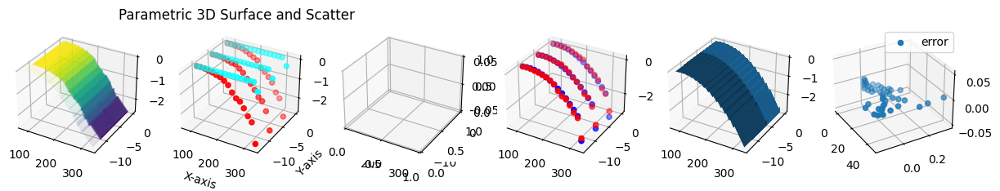

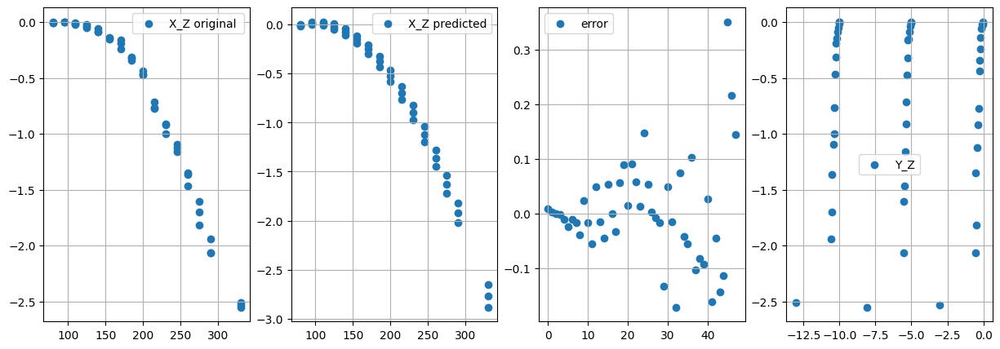

//////// ******************** ///////
Mse is :  0.028704317421893846


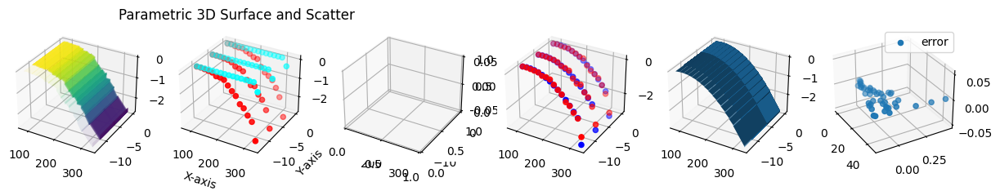

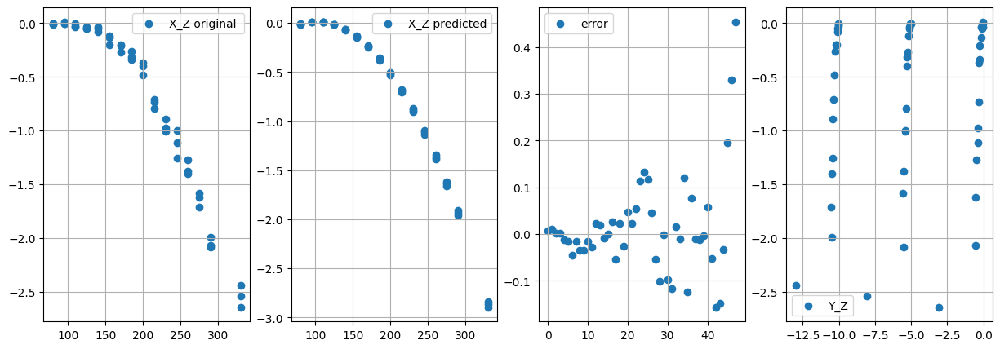

//////// ******************** ///////
Mse is :  0.01672238306143019


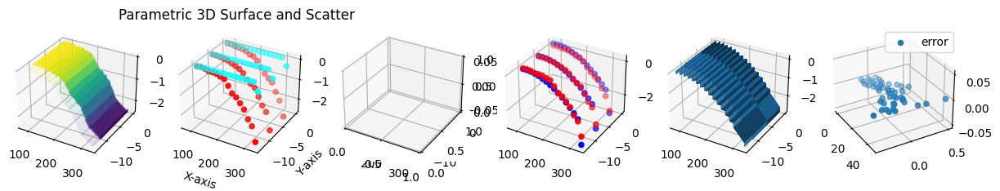

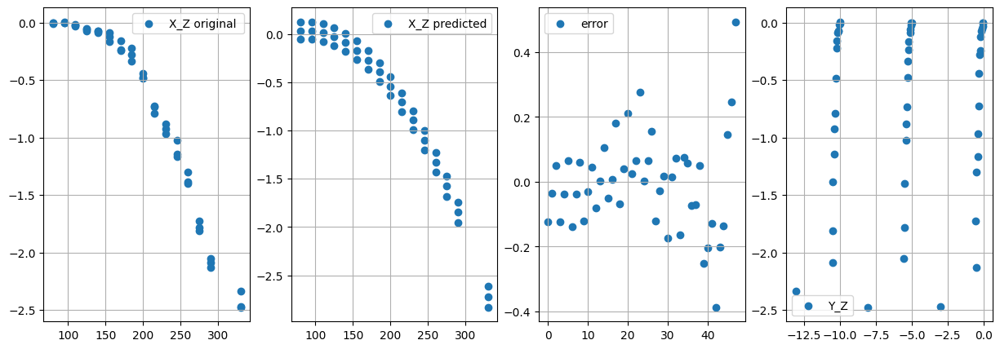

//////// ******************** ///////
Mse is :  0.019752097227856907


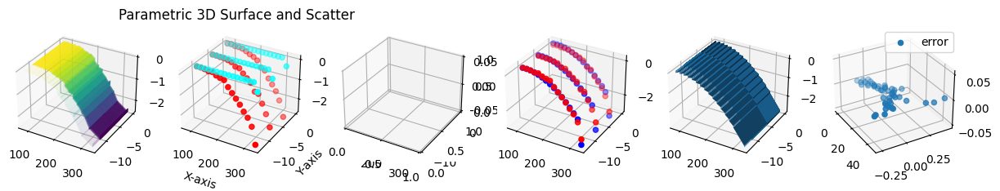

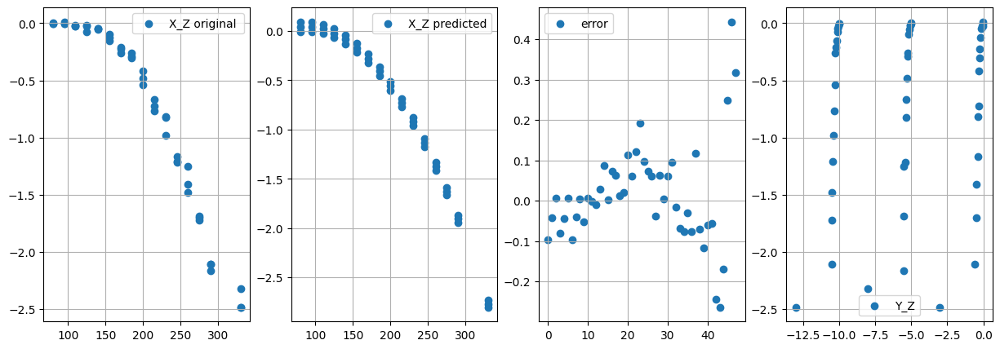

//////// ******************** ///////
Mse is :  0.035297468413345585


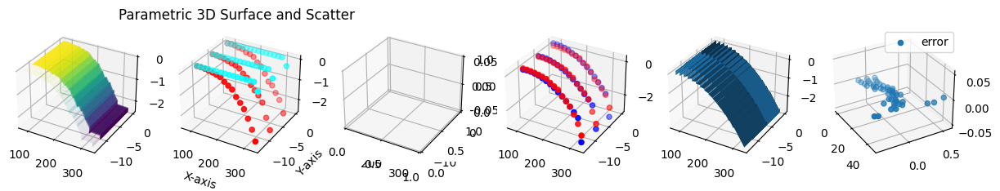

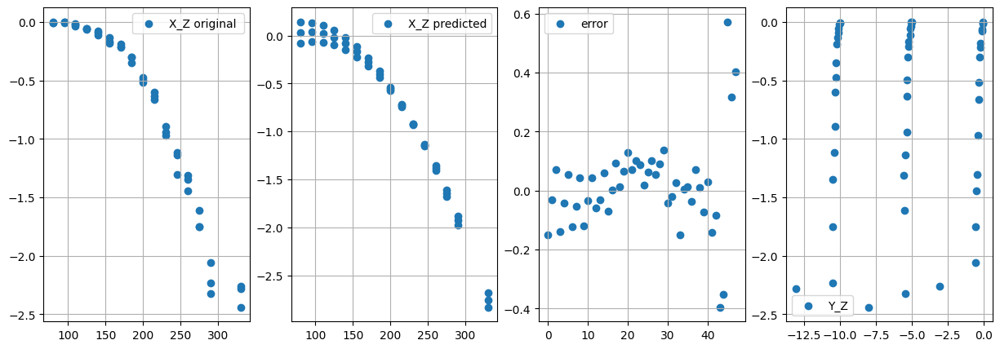

//////// ******************** ///////
Mse is :  0.010666200197548631


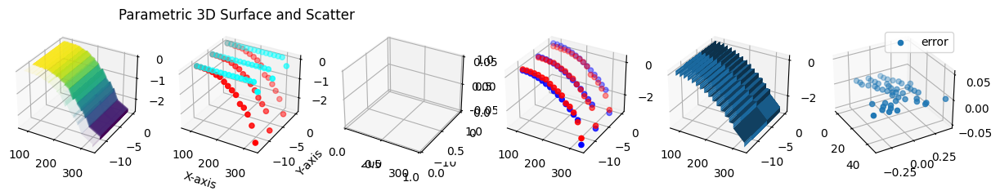

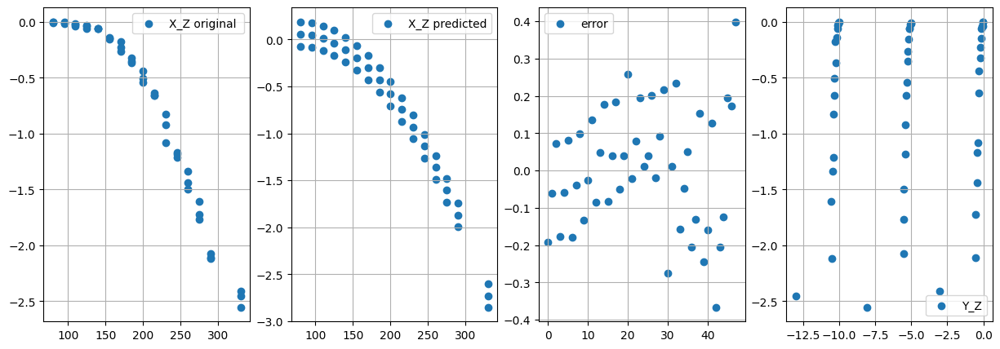

//////// ******************** ///////
Mse is :  0.005508591161626074


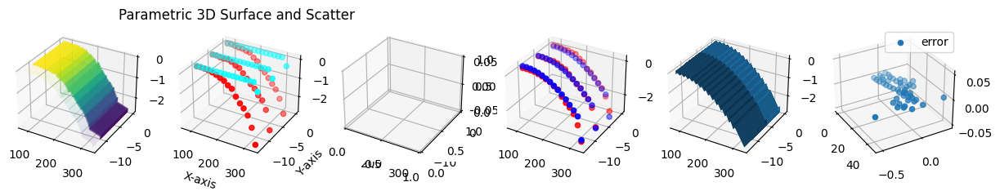

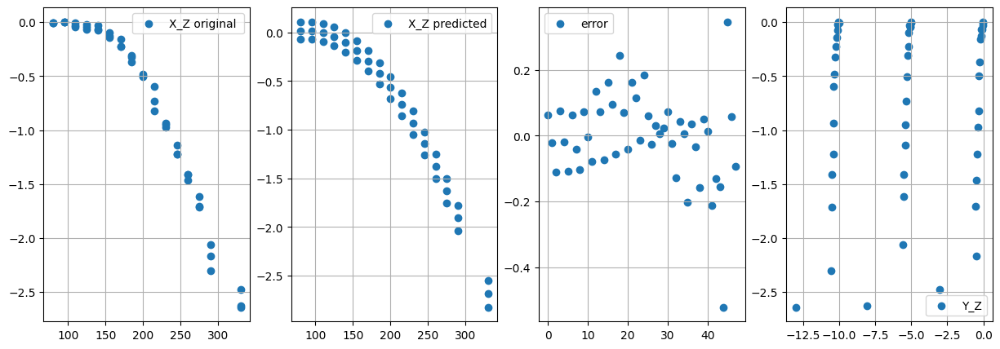

//////// ******************** ///////
Mse is :  0.01720944022736808


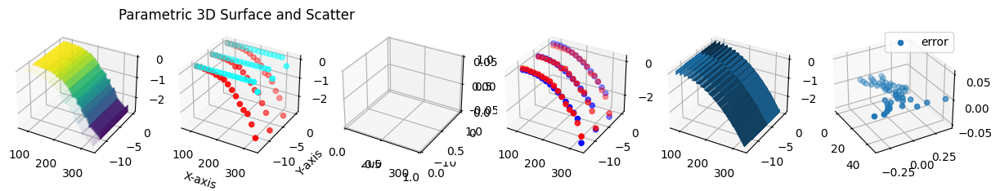

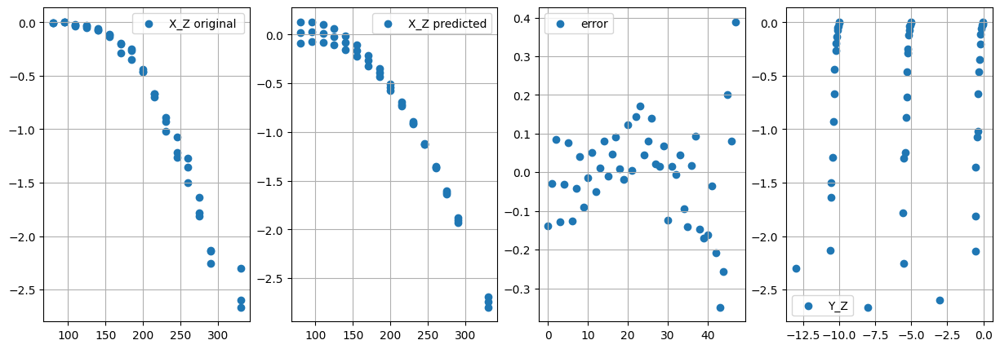

//////// ******************** ///////
Mse is :  0.014170855834270897


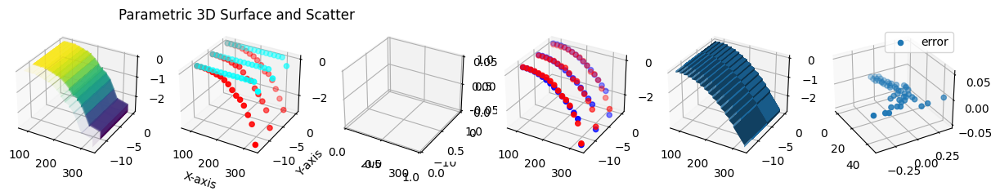

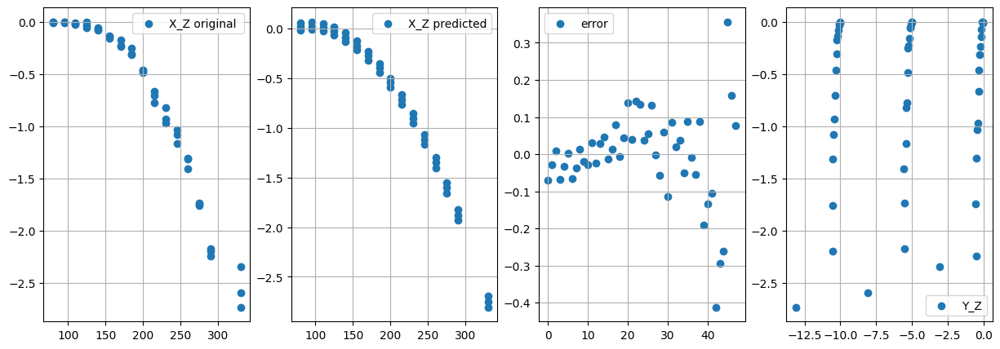

//////// ******************** ///////
Mse is :  0.006710660977655525


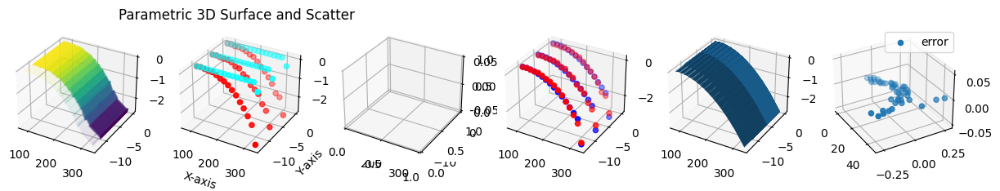

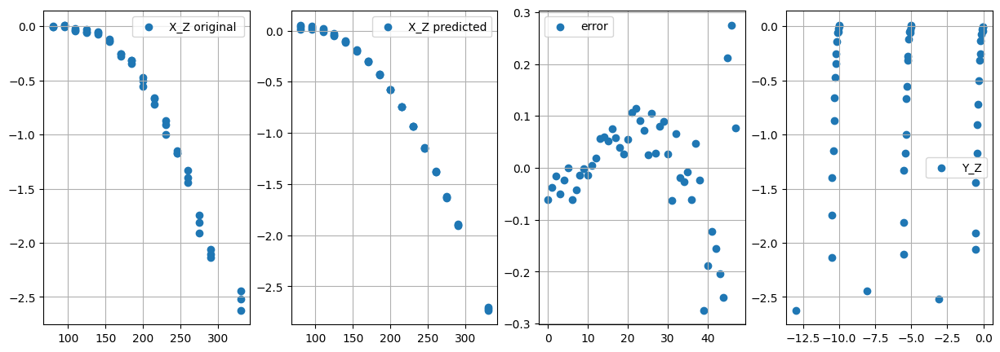

//////// ******************** ///////
Mse is :  0.006752838227257523


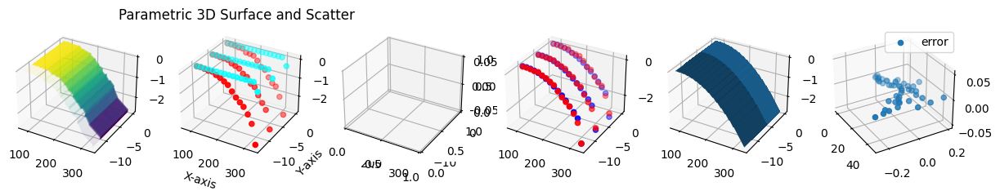

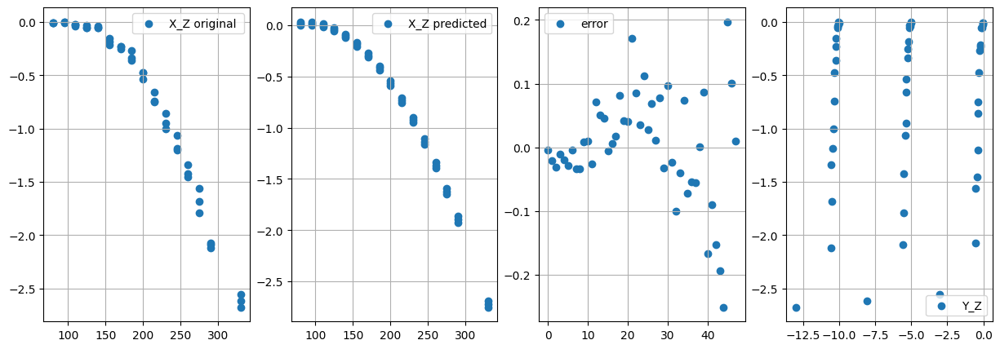

//////// ******************** ///////
Mse is :  0.024914389309739767


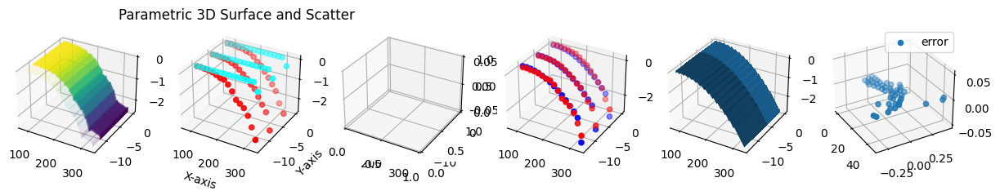

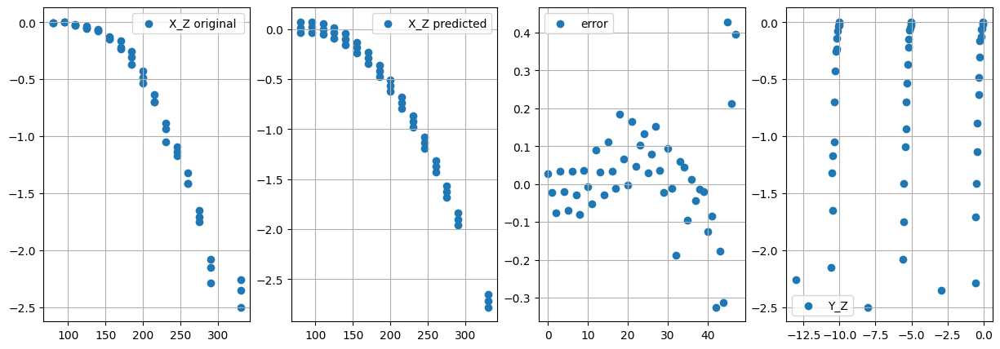

//////// ******************** ///////
Mse is :  0.006401021231314707


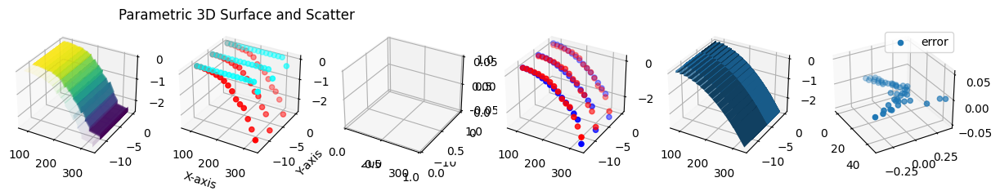

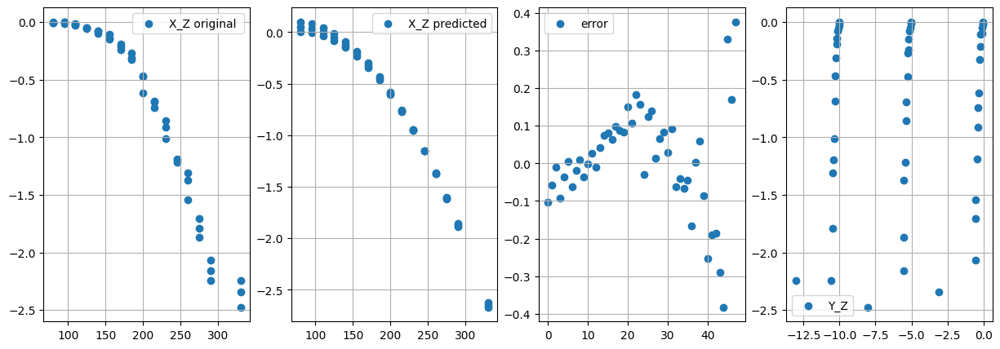

//////// ******************** ///////
Mse is :  0.011363339913800027


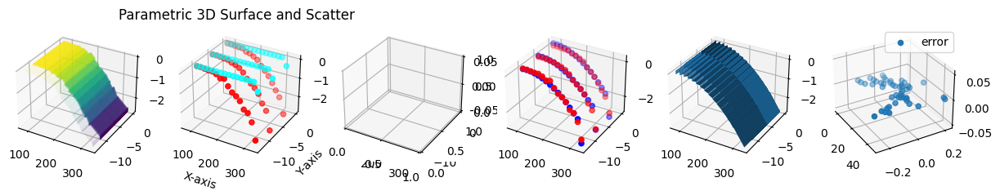

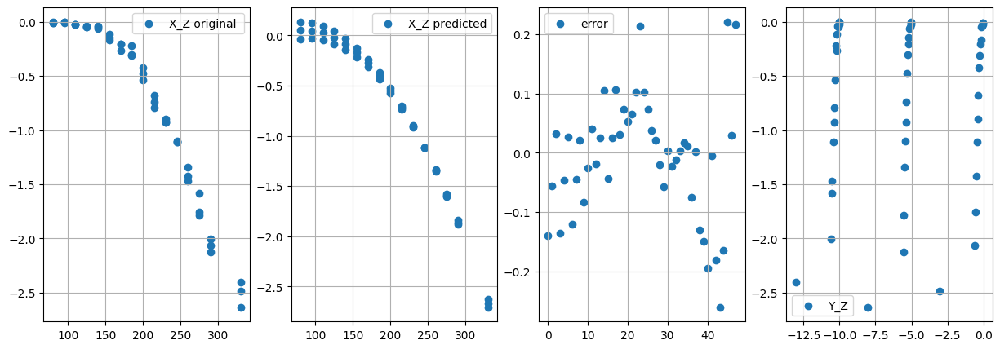

//////// ******************** ///////
Mse is :  0.008464282601896609


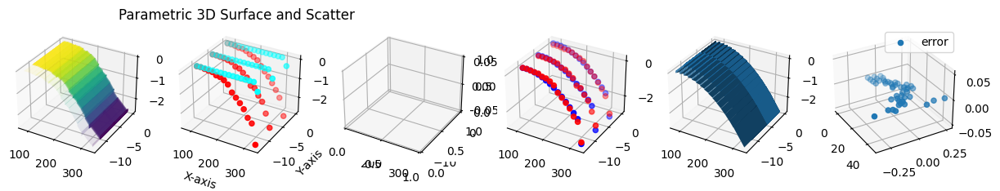

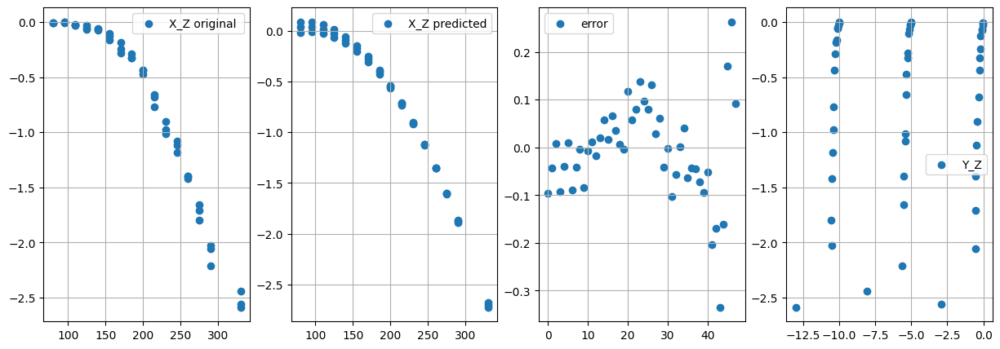

//////// ******************** ///////
Mse is :  0.013735500388810114


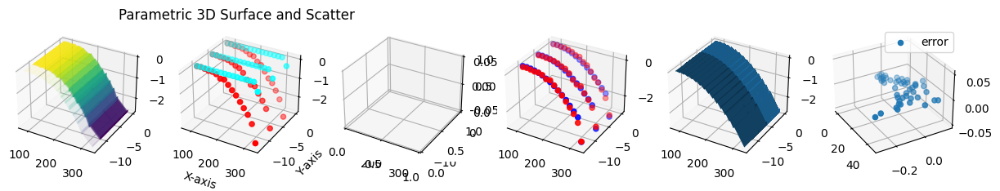

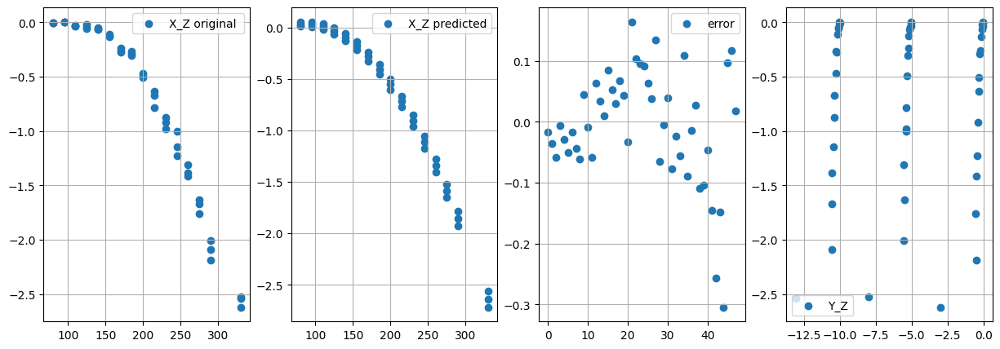

//////// ******************** ///////
Mse is :  0.010656776069718148


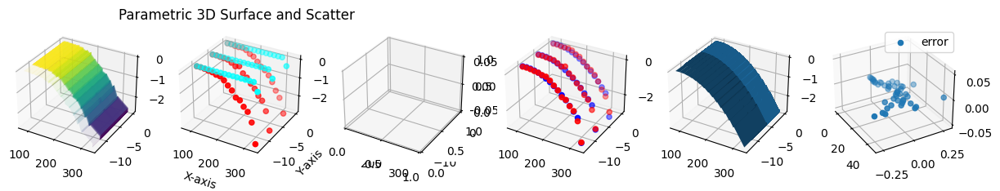

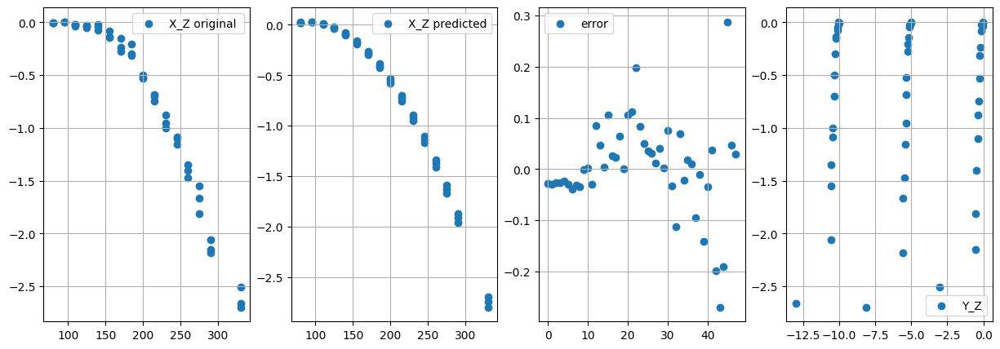

//////// ******************** ///////
Mse is :  0.02922293965808261


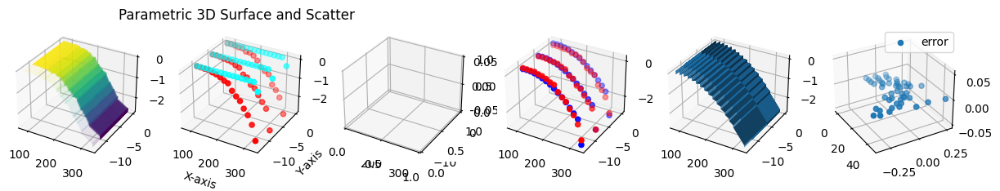

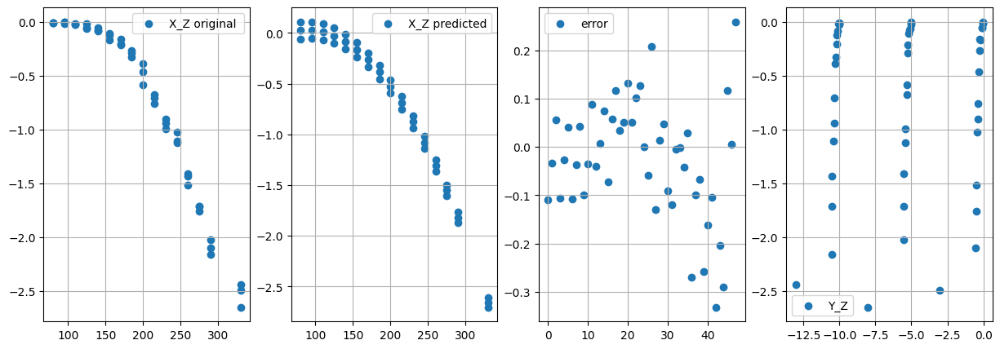

//////// ******************** ///////
Mse is :  0.016276789651381202


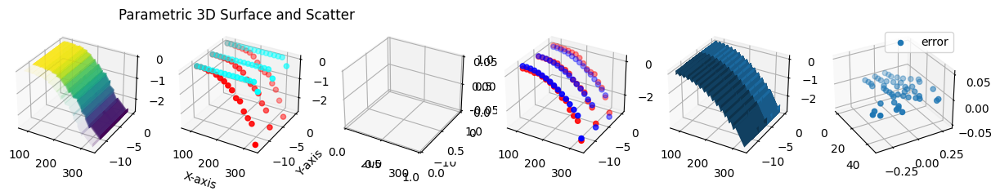

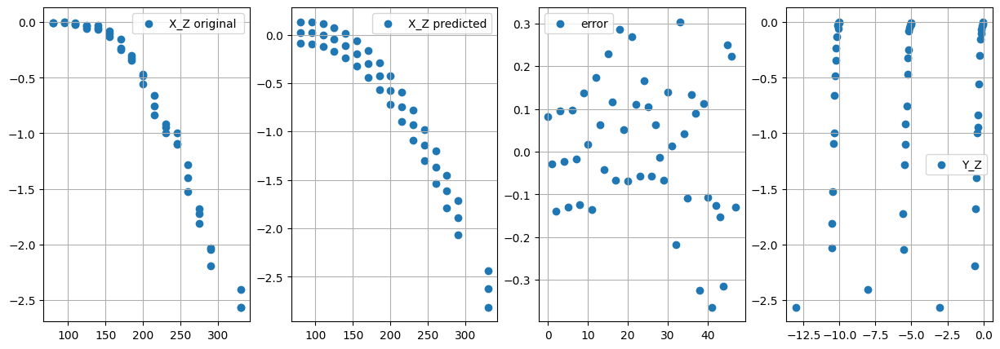

//////// ******************** ///////
Mse is :  0.01530414053435821


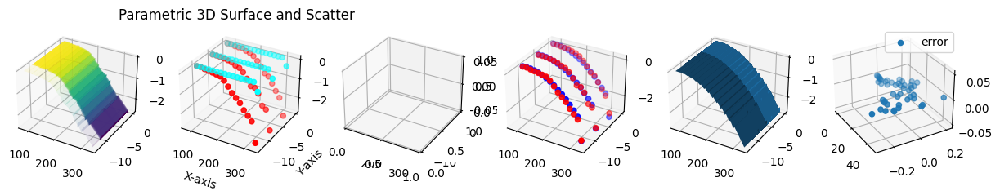

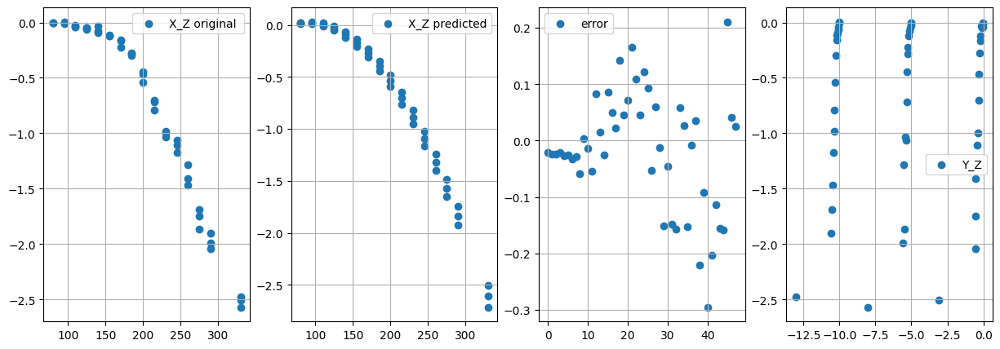

//////// ******************** ///////
Mse is :  0.02582521039734012


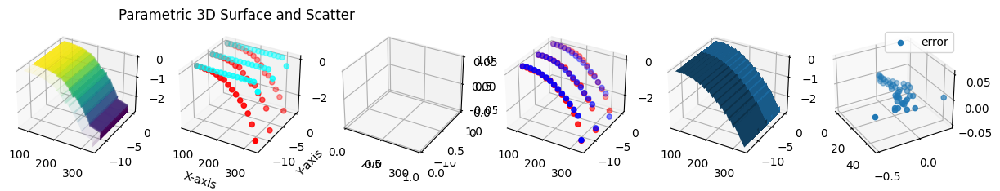

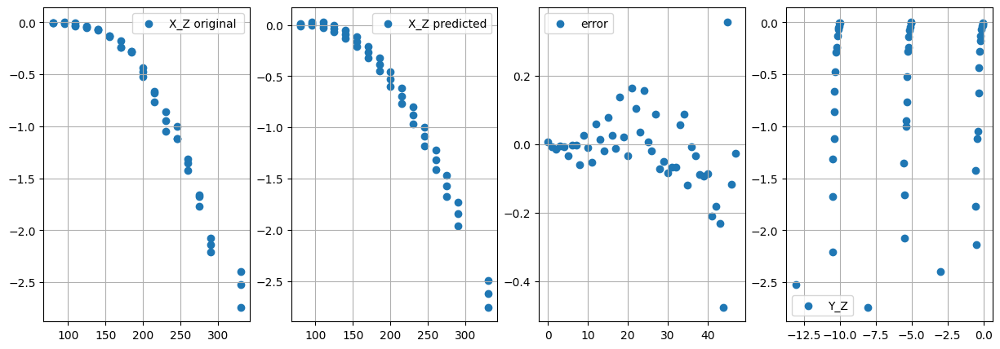

//////// ******************** ///////
Mse is :  0.023340533666082255


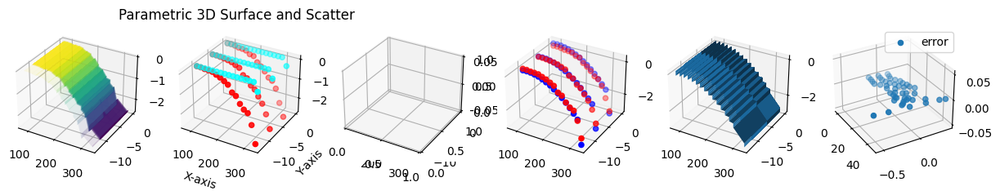

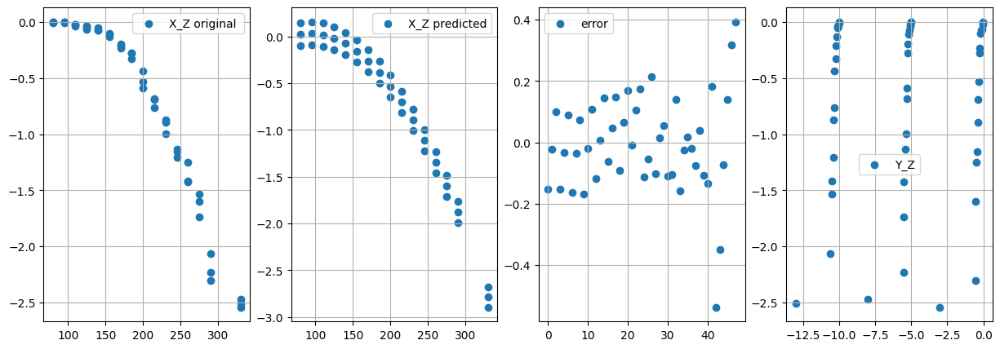

//////// ******************** ///////
Mse is :  0.021268599671548507


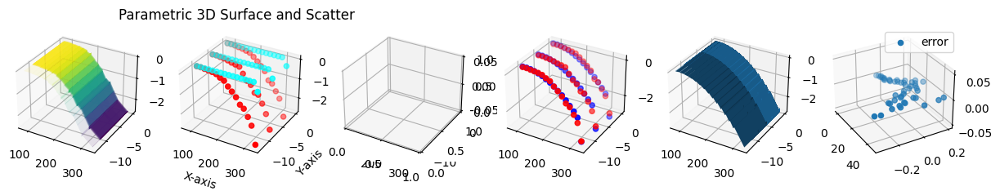

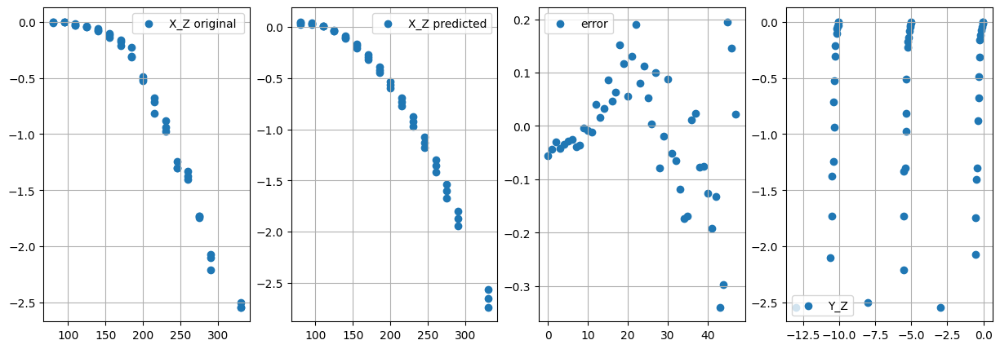

//////// ******************** ///////
Mse is :  0.013707673025039944


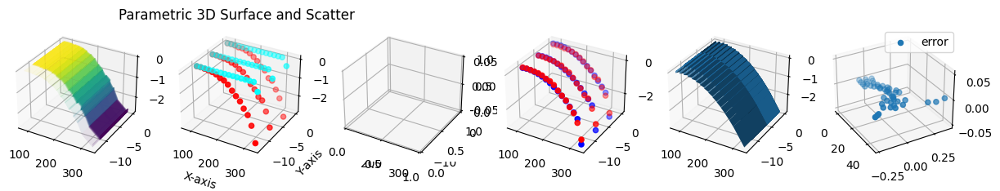

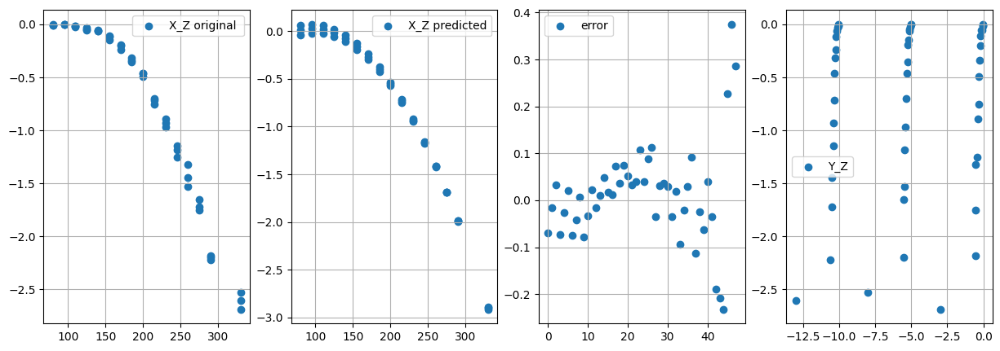

//////// ******************** ///////
Mse is :  0.0026191948232899068


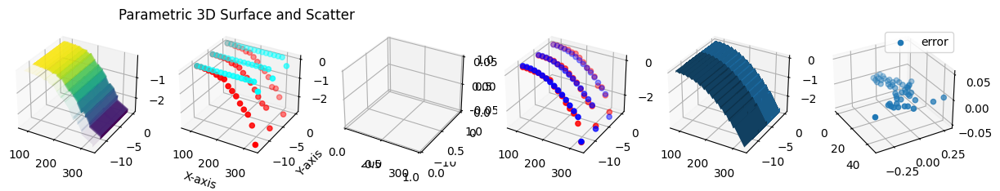

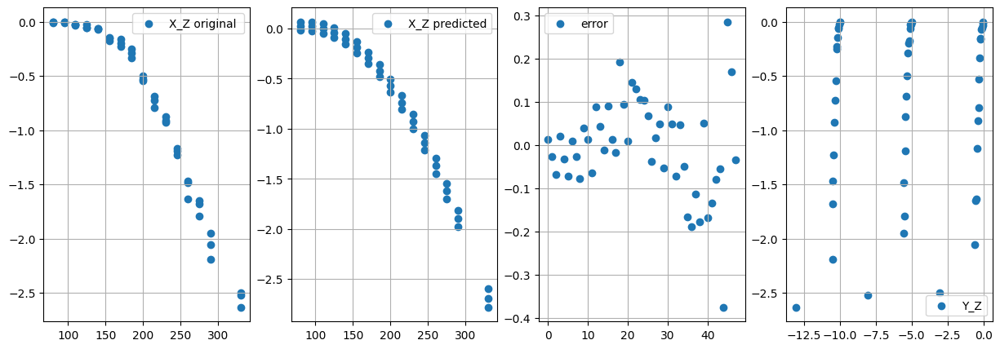

//////// ******************** ///////
Mse is :  0.1057548281968058


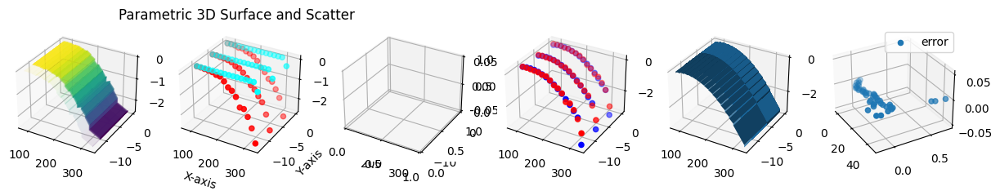

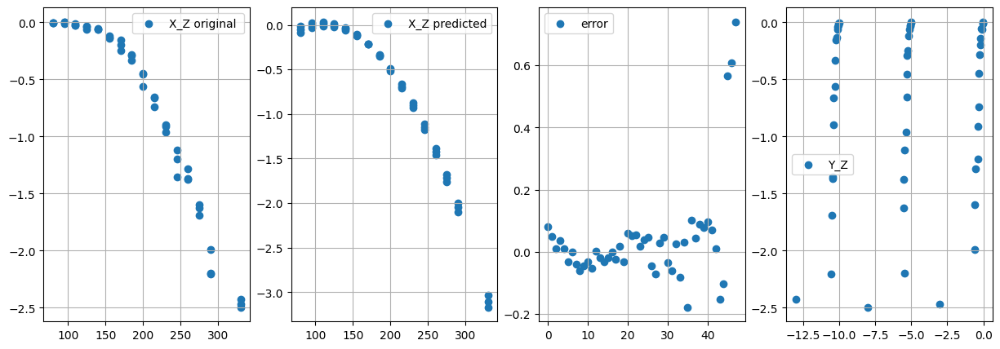

//////// ******************** ///////
Mse is :  0.018183728373922826


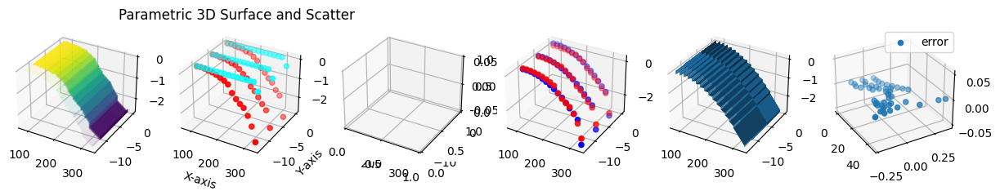

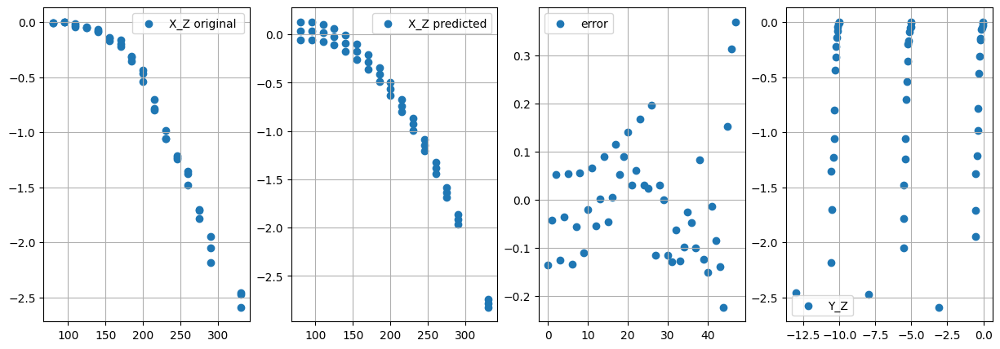

//////// ******************** ///////
Mse is :  0.008300469742188558


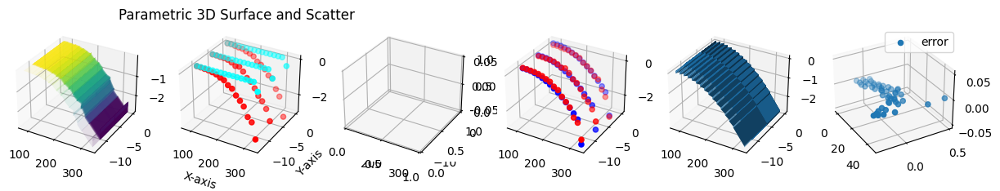

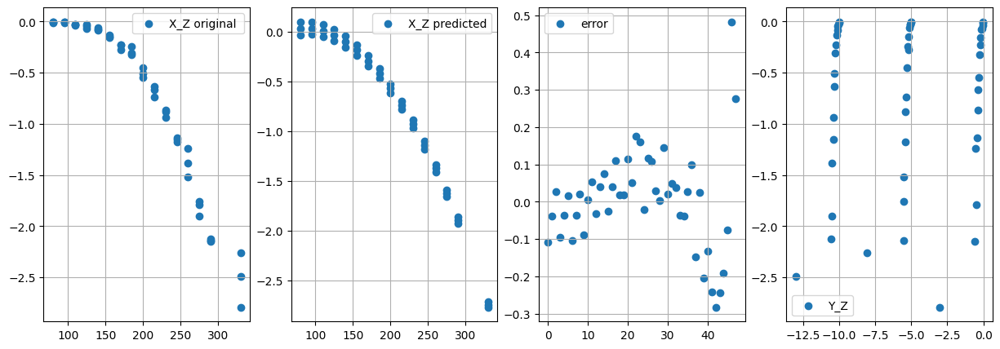

//////// ******************** ///////
Mse is :  0.0593275363885446


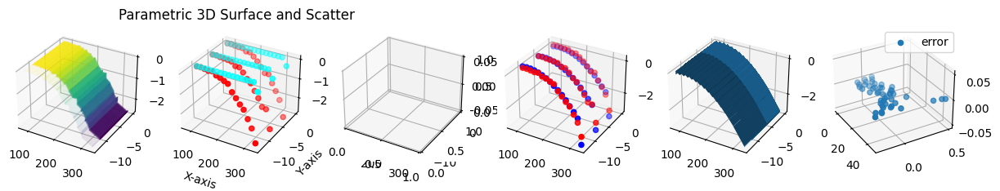

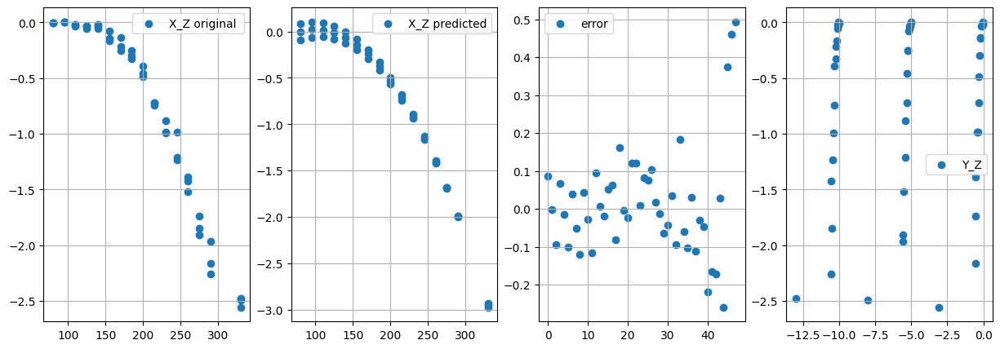

//////// ******************** ///////
Mse is :  0.0031371545136424325


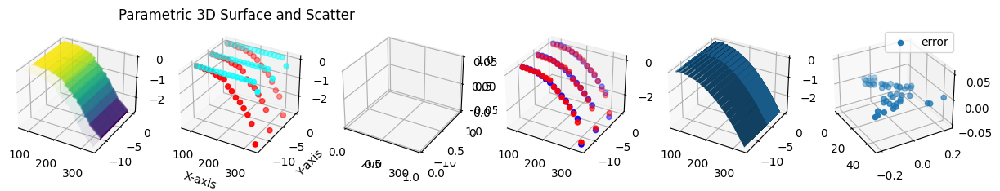

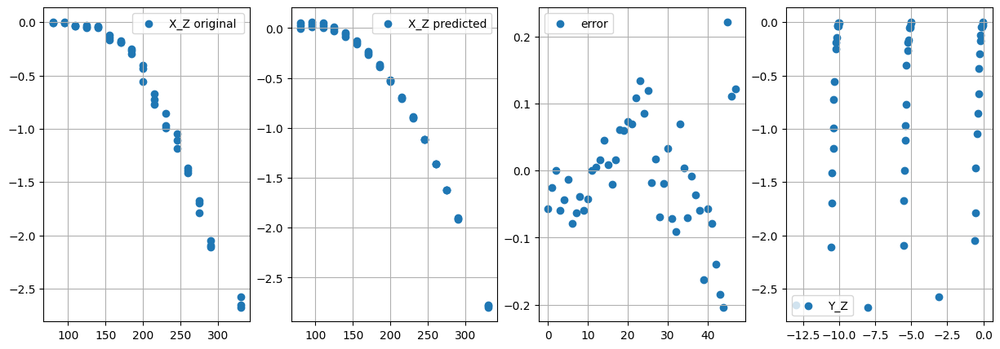

//////// ******************** ///////
Mse is :  0.004206592516012106


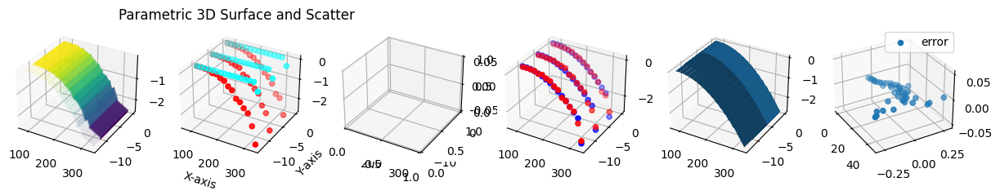

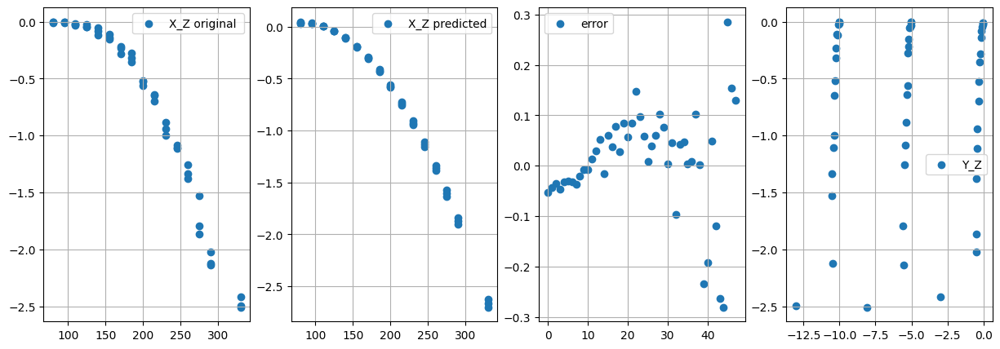

//////// ******************** ///////
Mse is :  0.015977493952382776


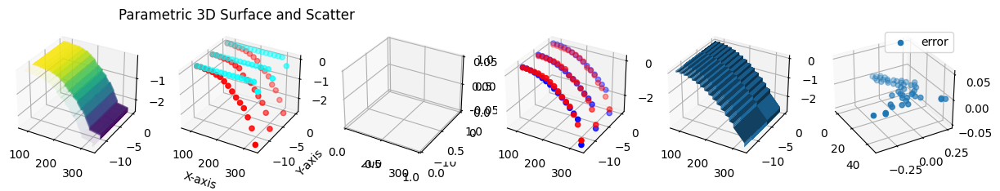

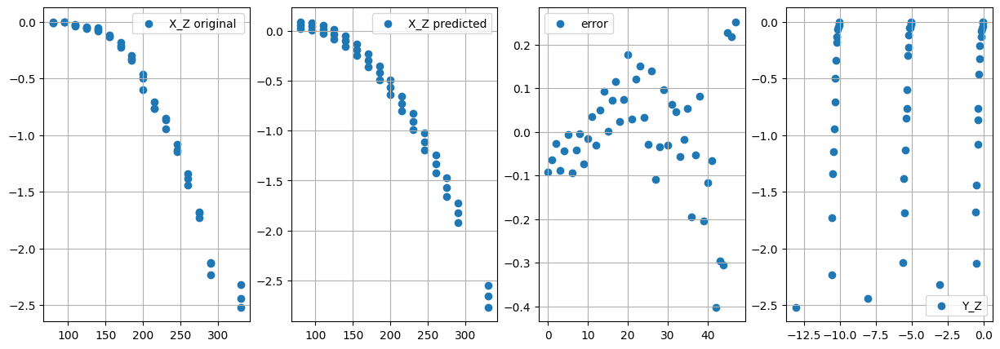

//////// ******************** ///////
Mse is :  0.05104513578437995


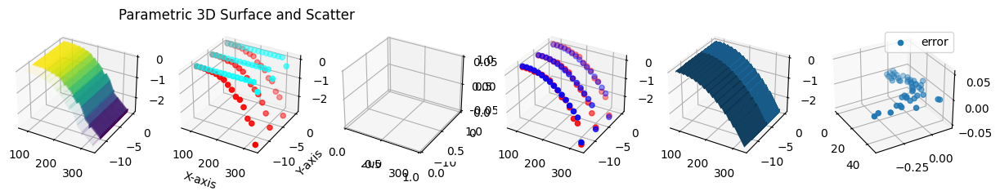

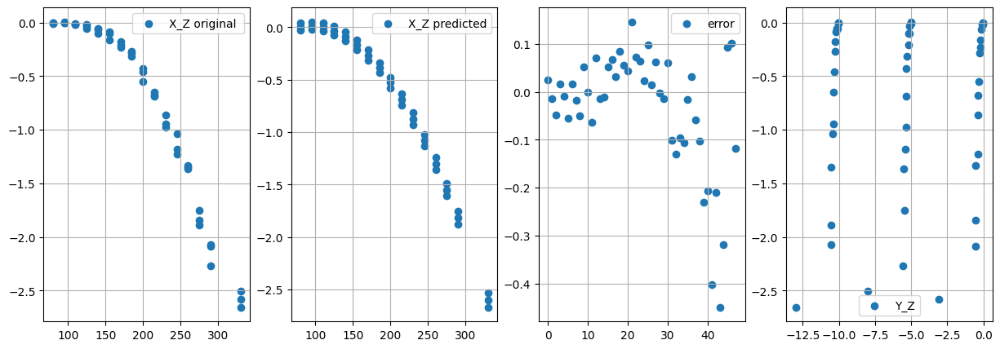

//////// ******************** ///////
Mse is :  0.014728391246423632


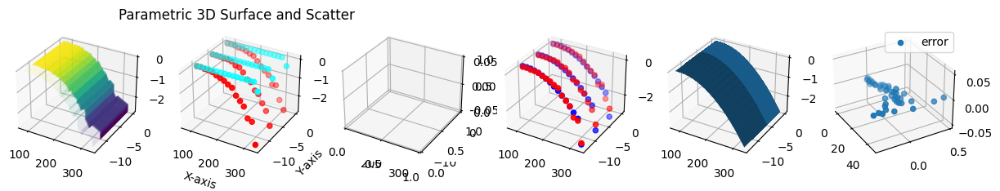

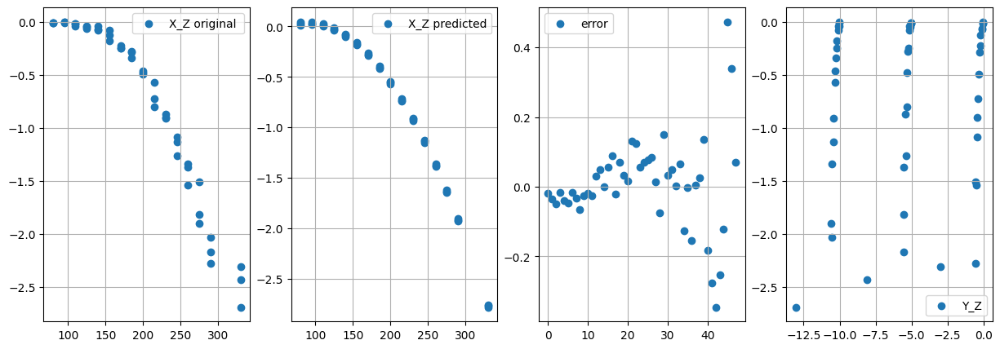

//////// ******************** ///////
Mse is :  0.04646522644772966


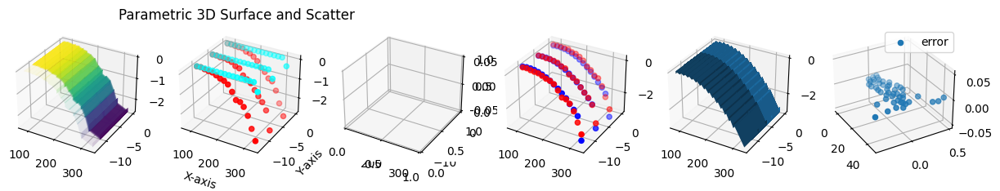

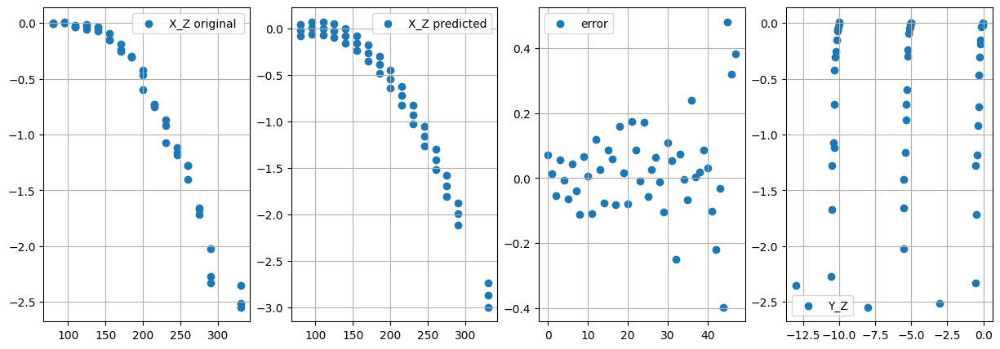

//////// ******************** ///////
Mse is :  0.020807615146562496


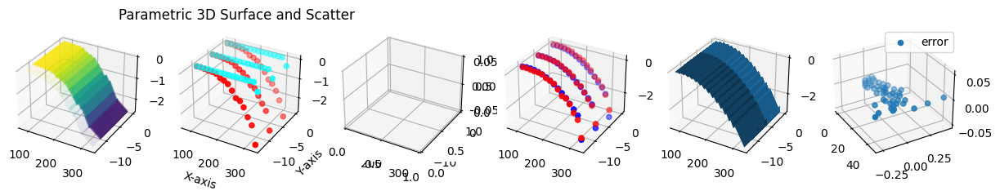

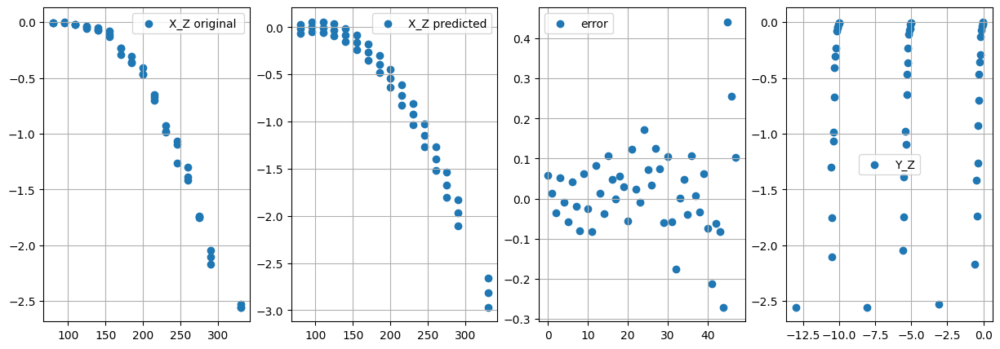

//////// ******************** ///////
Mse is :  0.015863167421122964


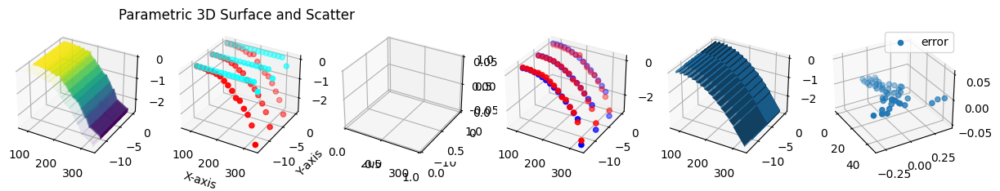

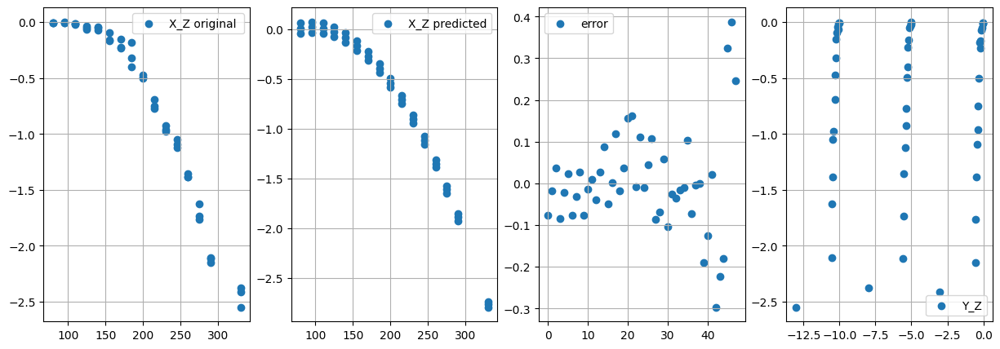

//////// ******************** ///////
Mse is :  0.025268961697887823


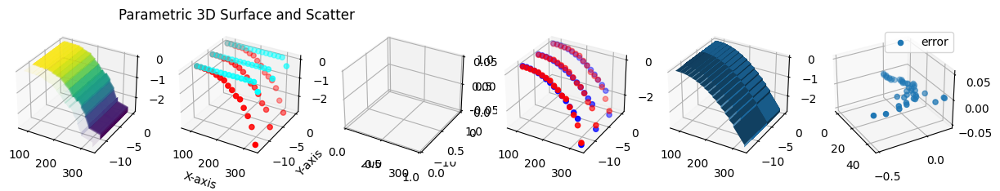

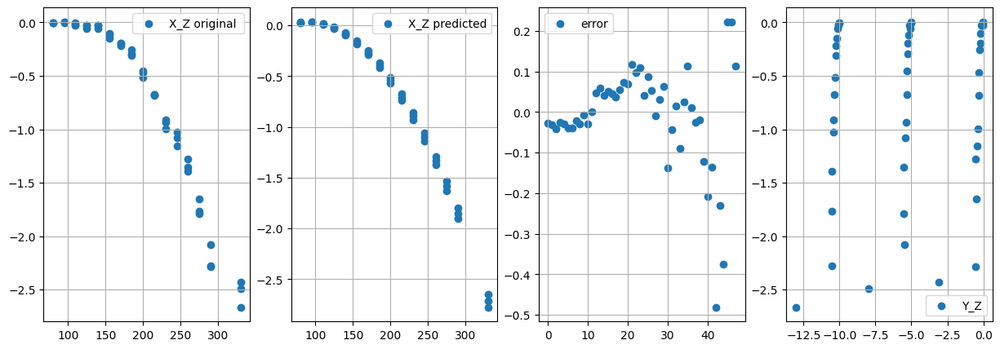

//////// ******************** ///////
Mse is :  0.024994280225280097


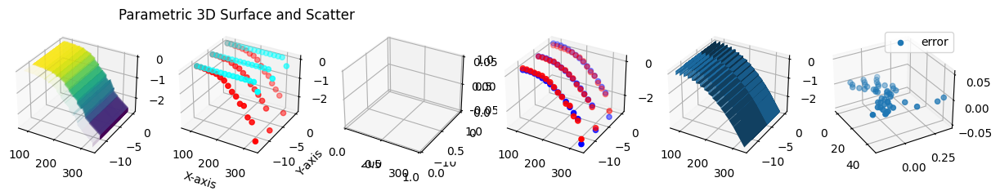

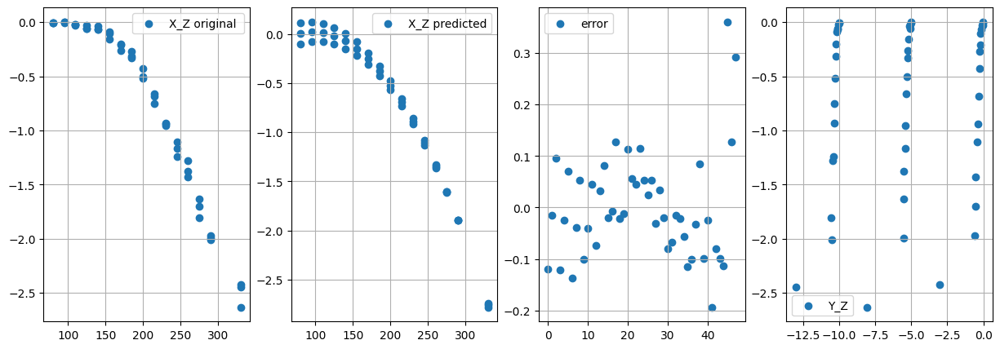

//////// ******************** ///////
Mse is :  0.029814932880734696


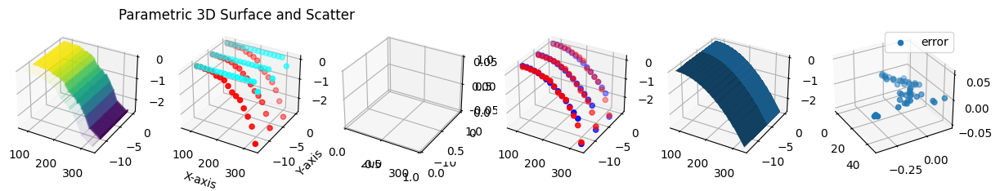

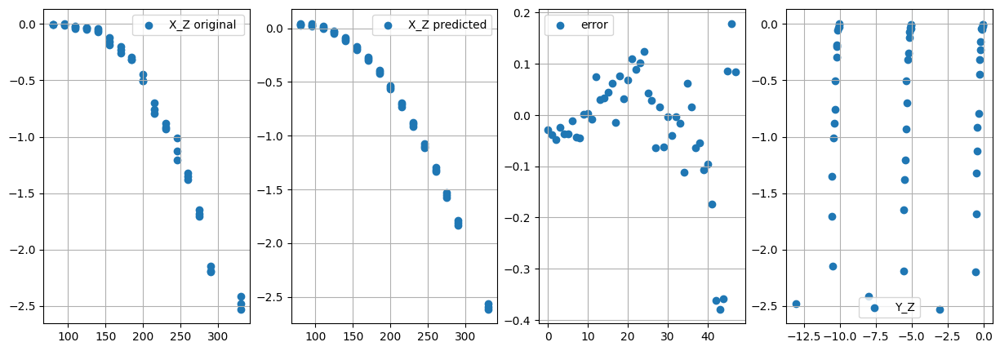

//////// ******************** ///////
Mse is :  0.0130776209839736


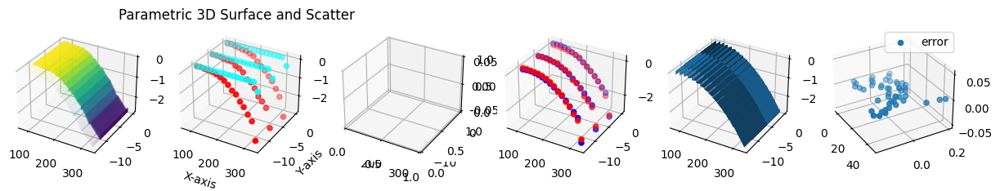

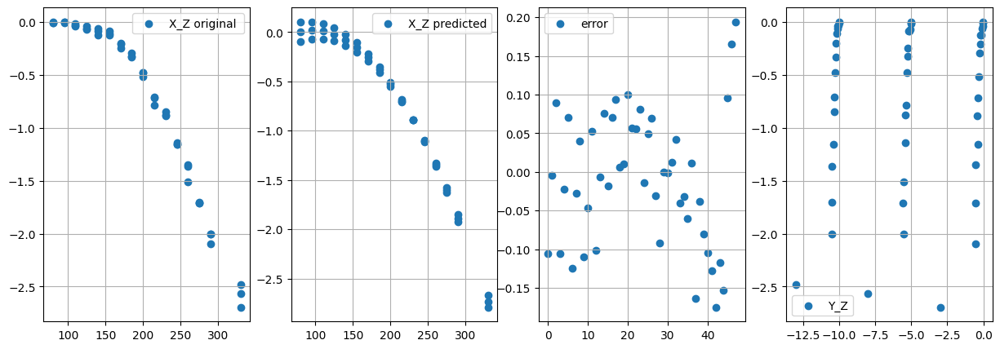

//////// ******************** ///////
Mse is :  0.0363373516230122


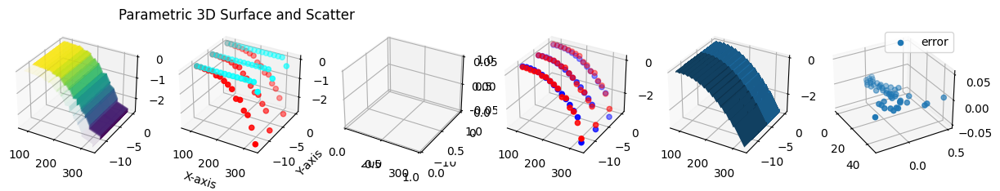

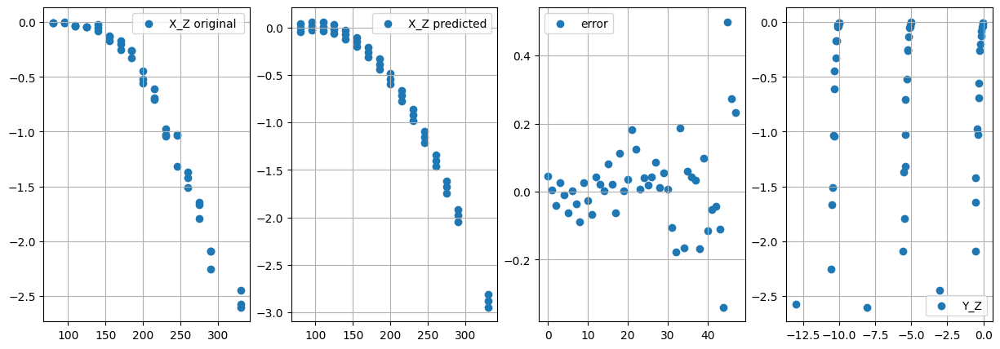

//////// ******************** ///////
Mse is :  0.039221434511898114


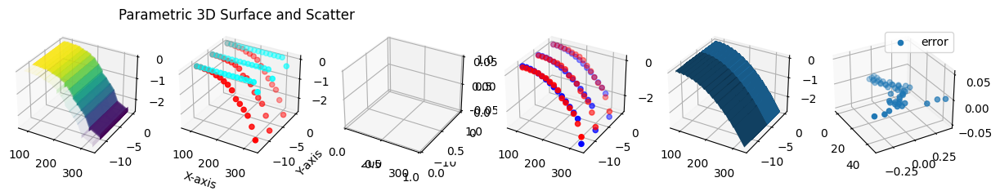

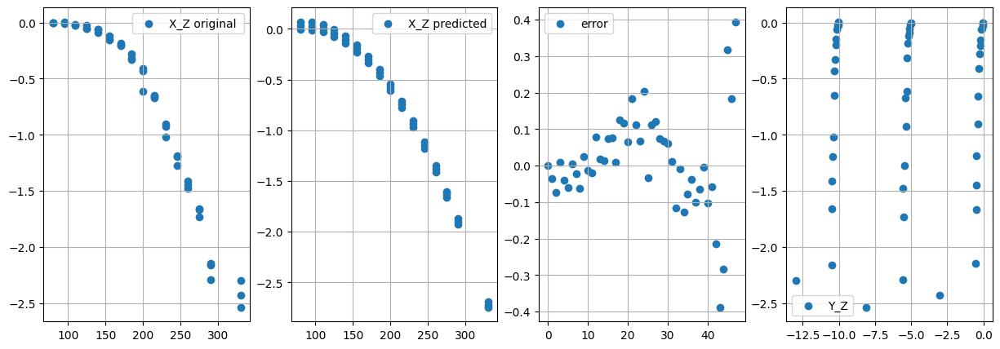

//////// ******************** ///////
Mse is :  0.011774271964859721


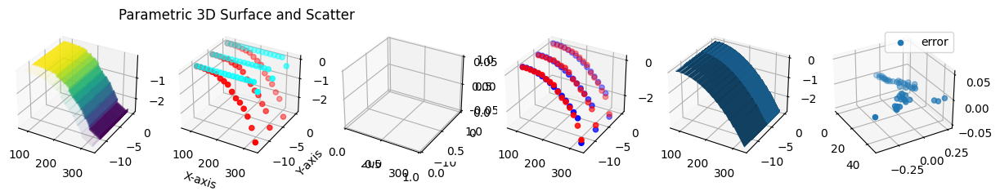

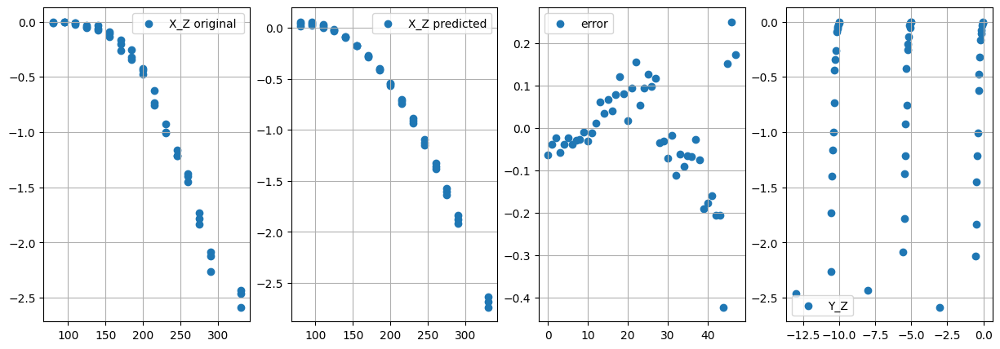

//////// ******************** ///////
Mse is :  0.026300092400152426


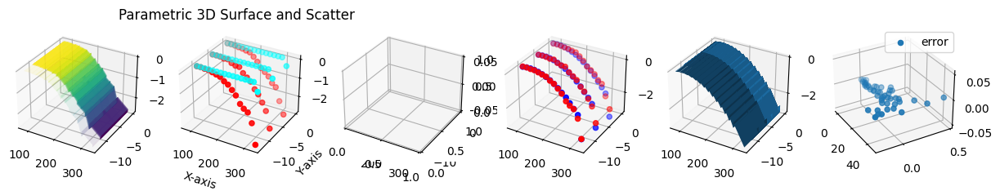

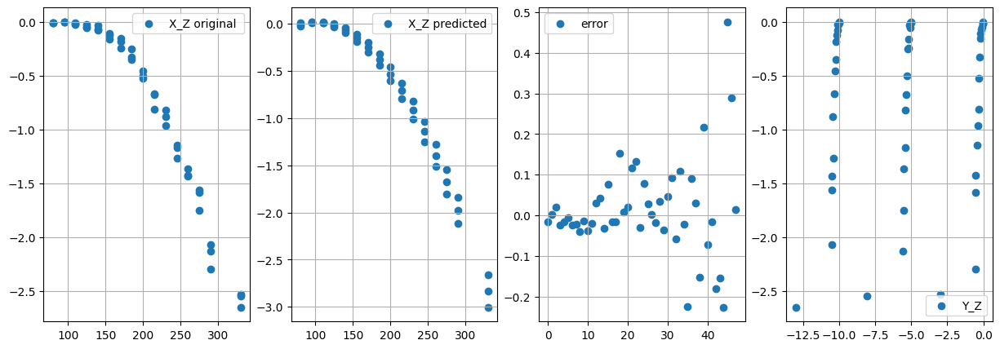

//////// ******************** ///////
Mse is :  0.008990886153287317


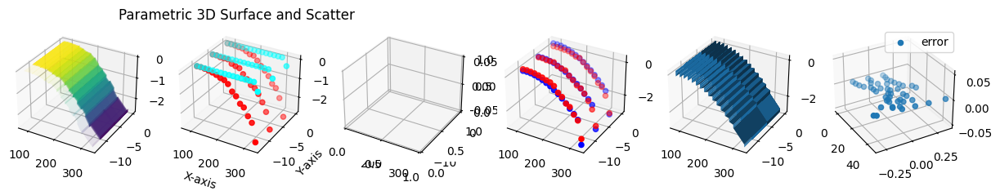

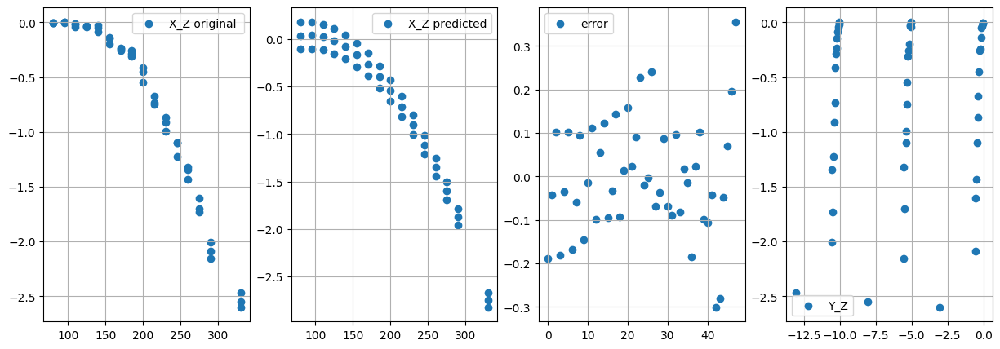

//////// ******************** ///////
Mse is :  0.015705921744900823


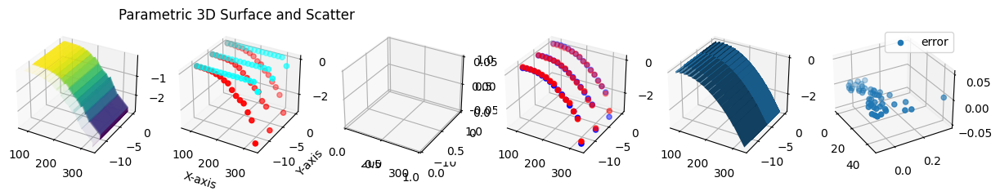

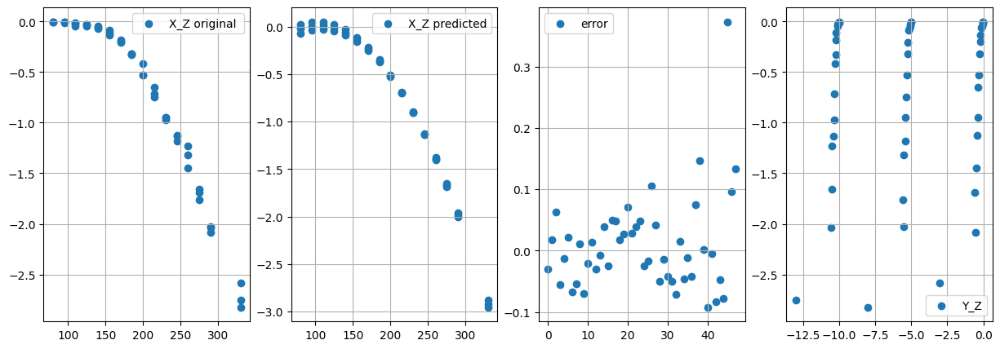

//////// ******************** ///////
Mse is :  0.002294085464503899


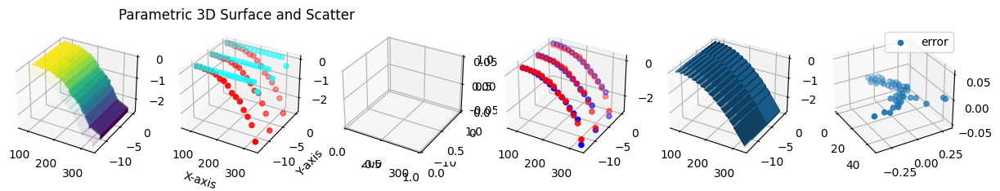

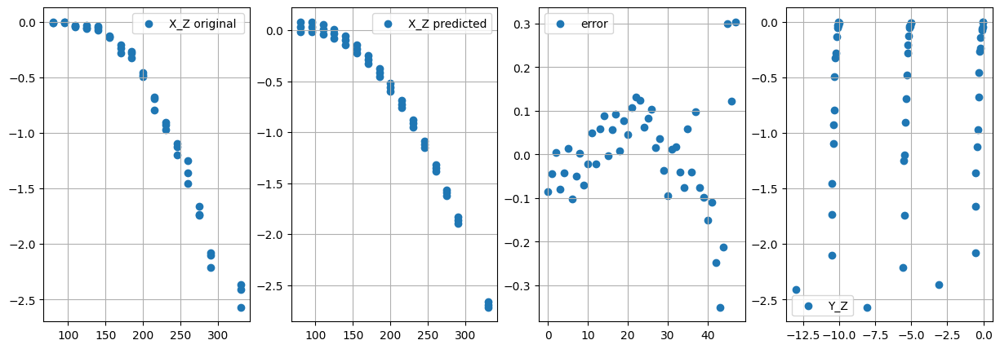

//////// ******************** ///////
Mse is :  0.02234195343571964


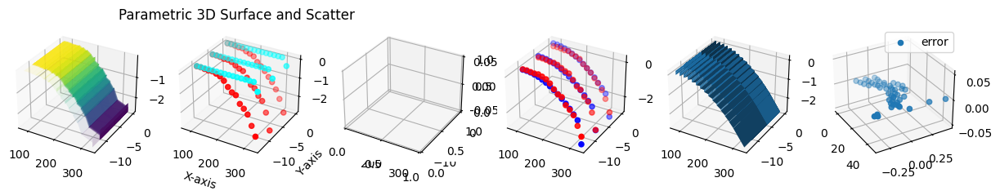

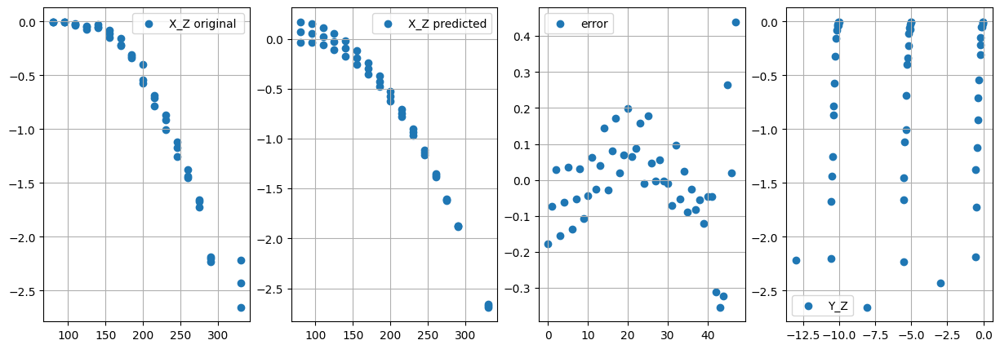

//////// ******************** ///////
Mse is :  0.016942877785619523


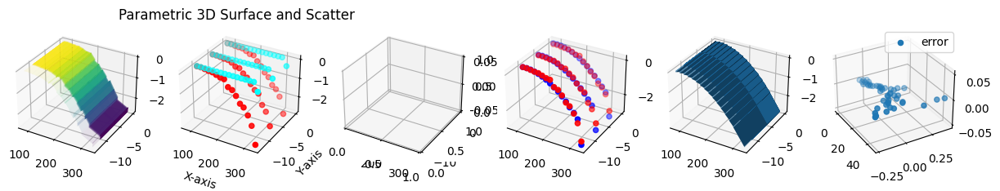

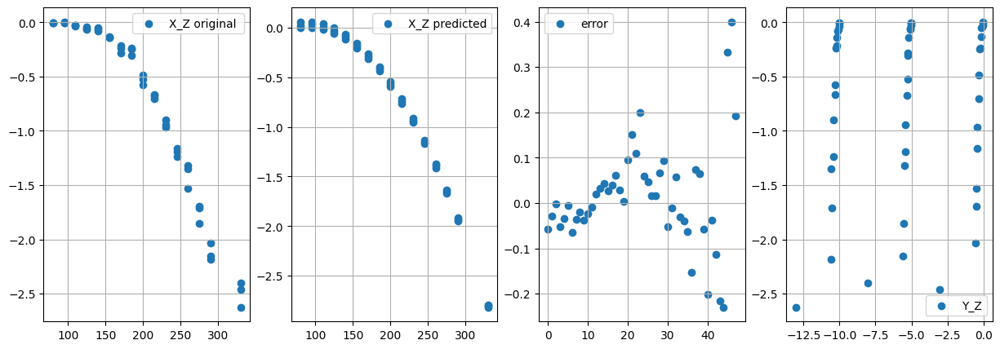

//////// ******************** ///////
Mse is :  0.028301014610514538


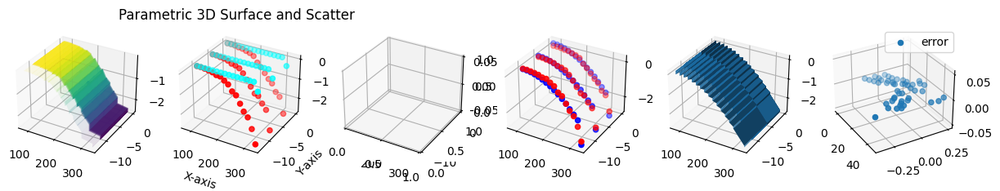

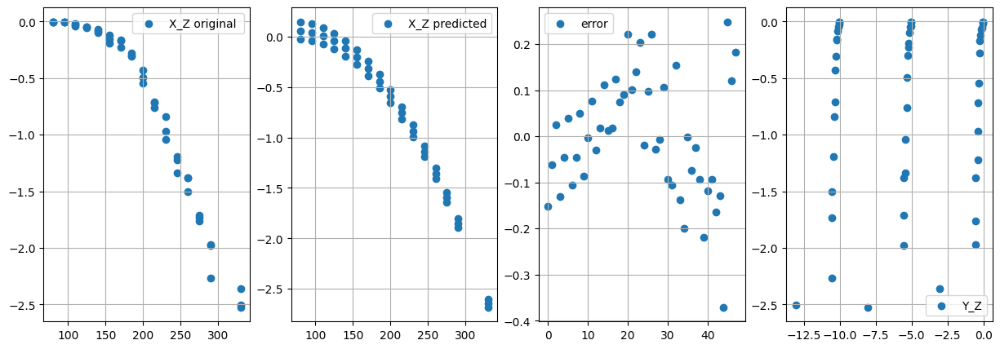

//////// ******************** ///////
Mse is :  0.02206507225923446


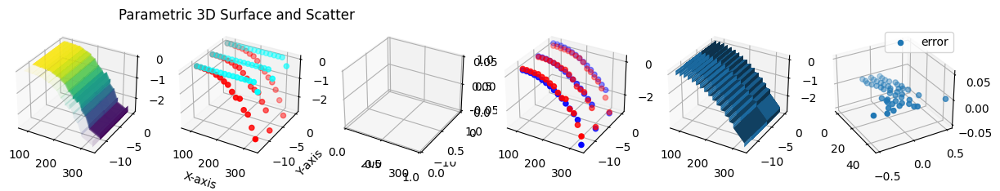

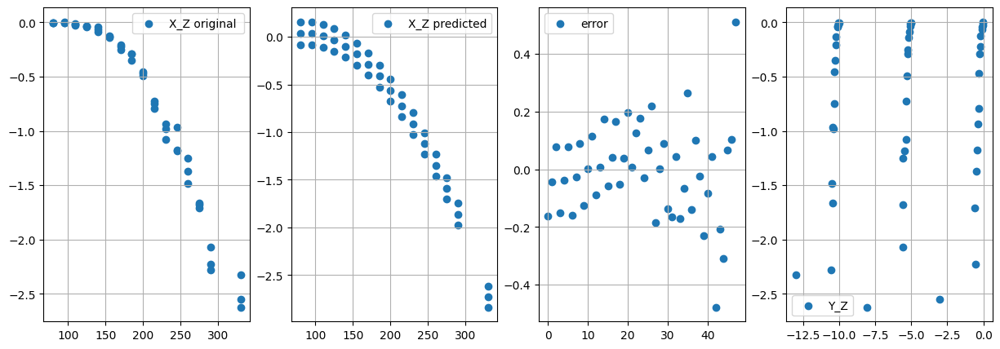

//////// ******************** ///////
Mse is :  0.005255617121578801


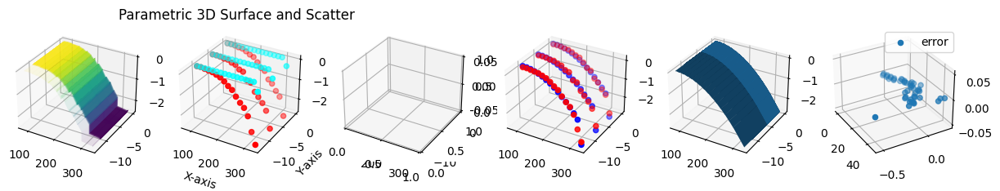

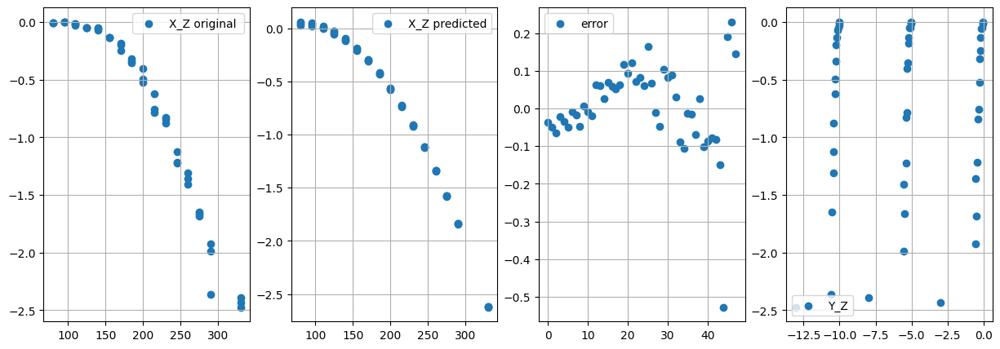

//////// ******************** ///////
Mse is :  0.020346970156250418


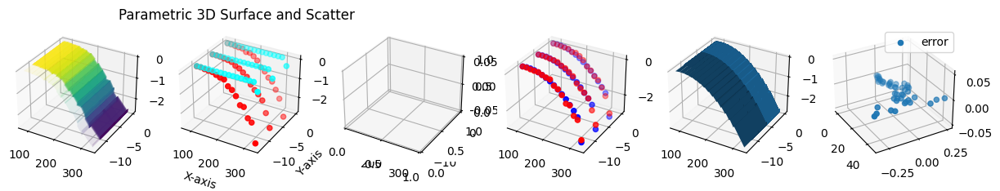

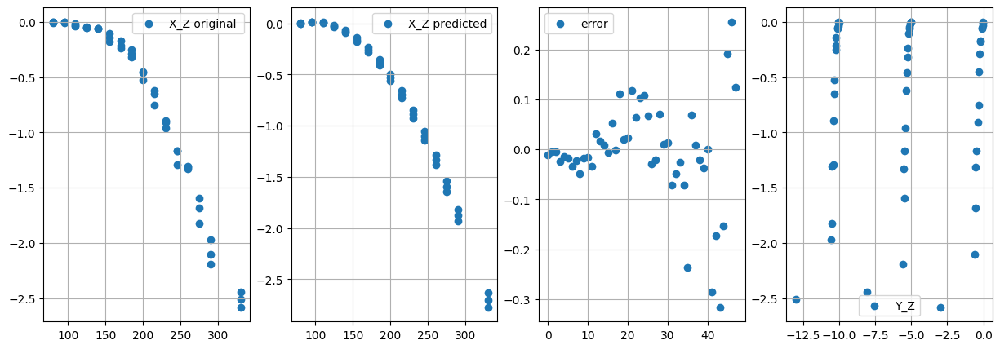

//////// ******************** ///////
Mse is :  0.006281544651474395


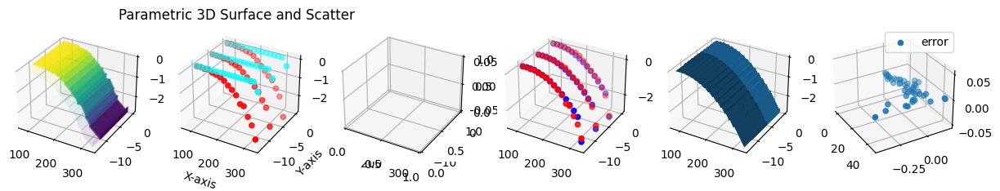

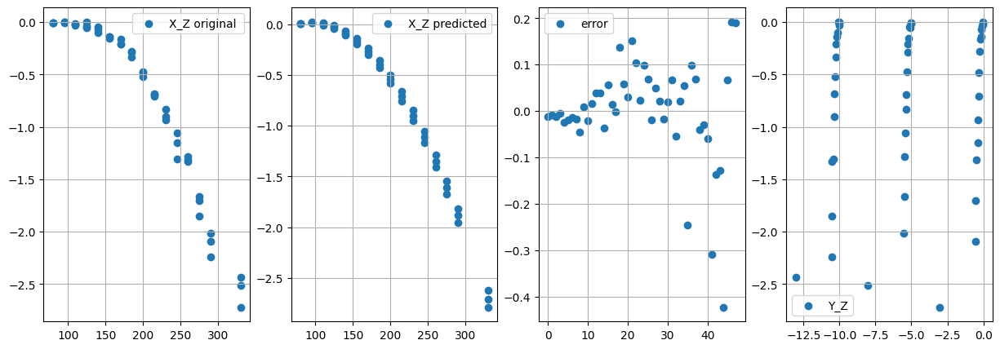

//////// ******************** ///////
Mse is :  0.021061392168424925


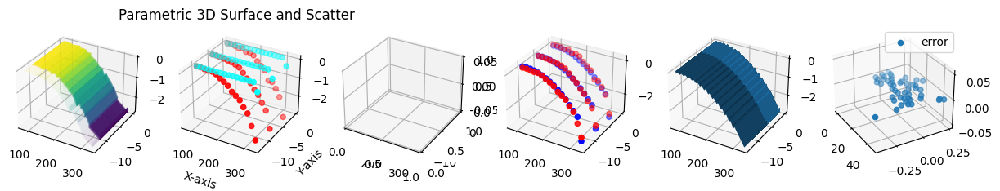

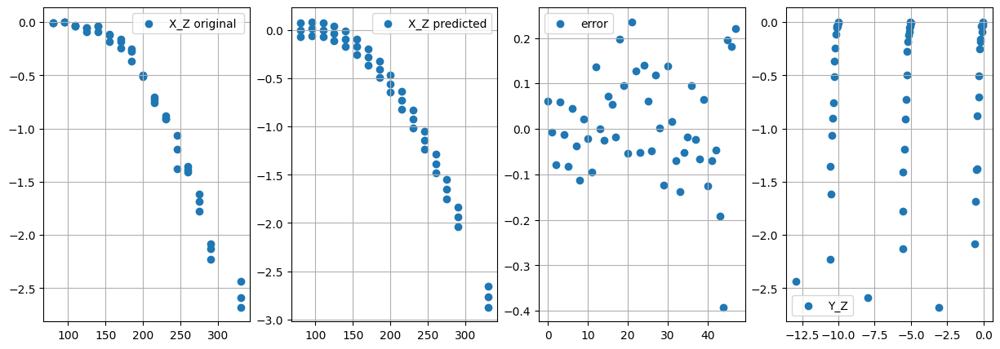

//////// ******************** ///////
Mse is :  0.042973577076365656


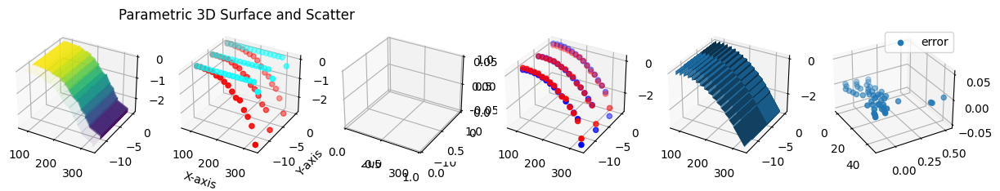

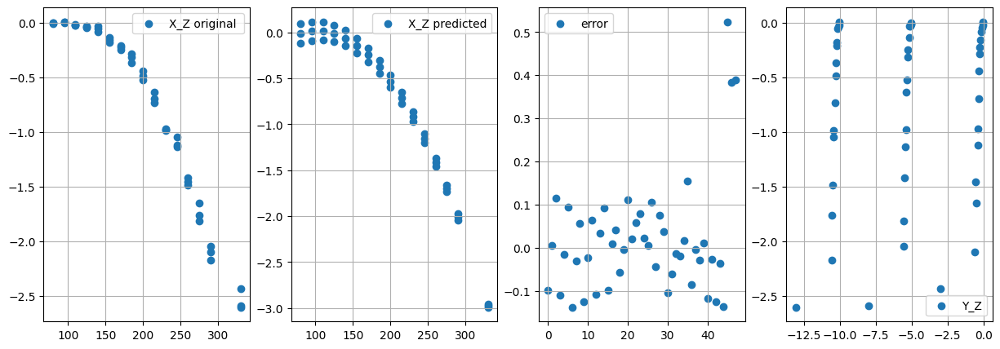

//////// ******************** ///////
Mse is :  0.007406947109534744


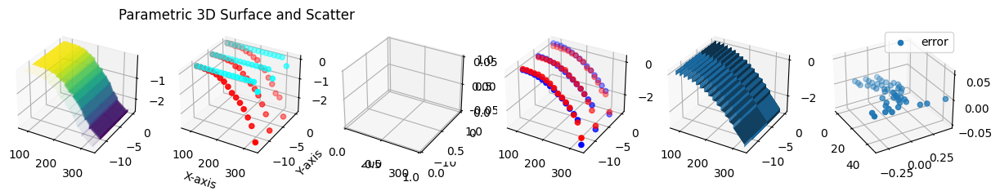

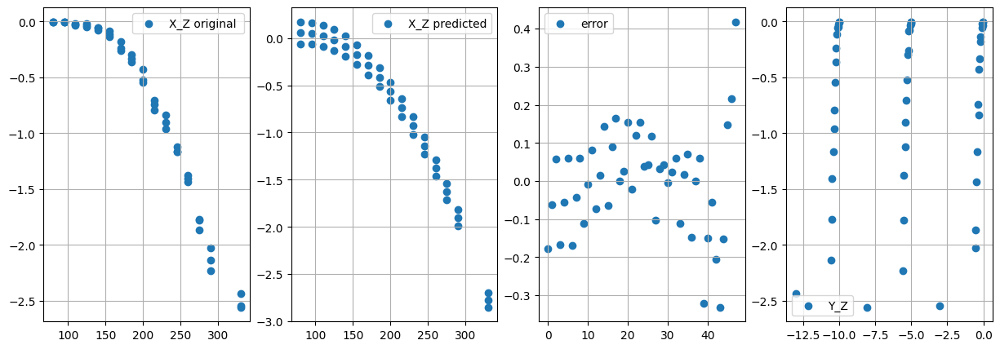

//////// ******************** ///////
Mse is :  0.016869946878807135


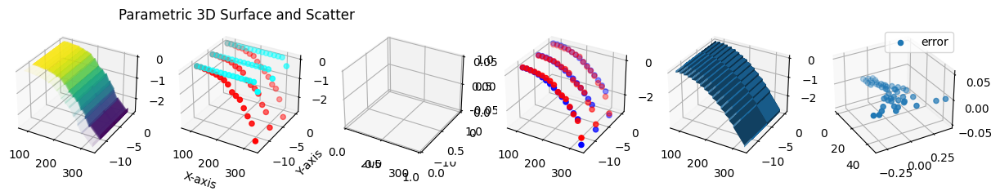

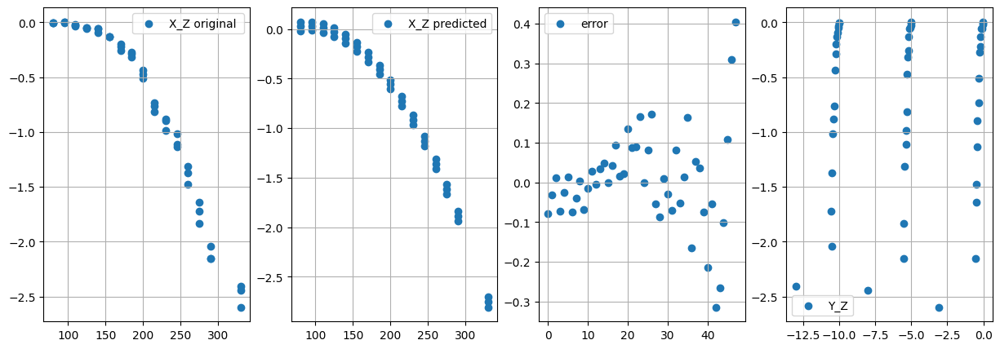

//////// ******************** ///////
Mse is :  0.02100403066289927


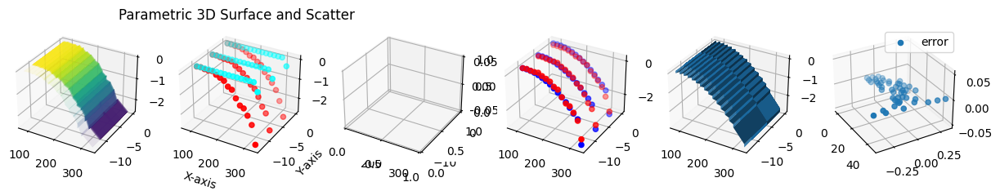

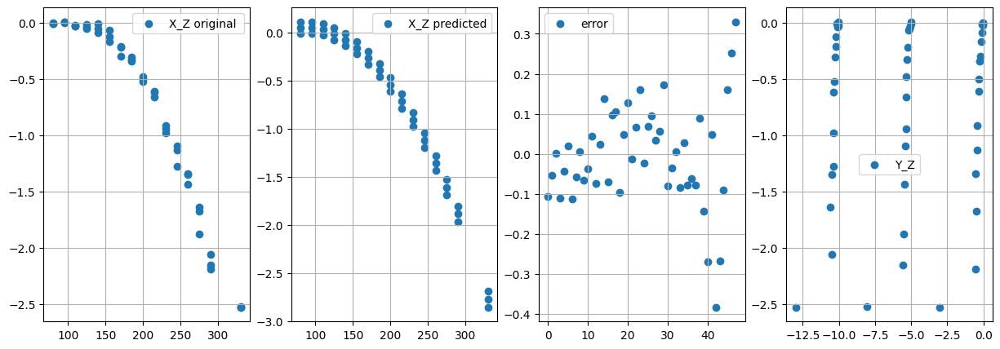

//////// ******************** ///////
Mse is :  0.0395583060204439


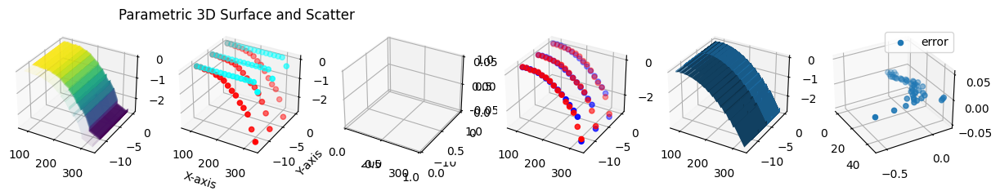

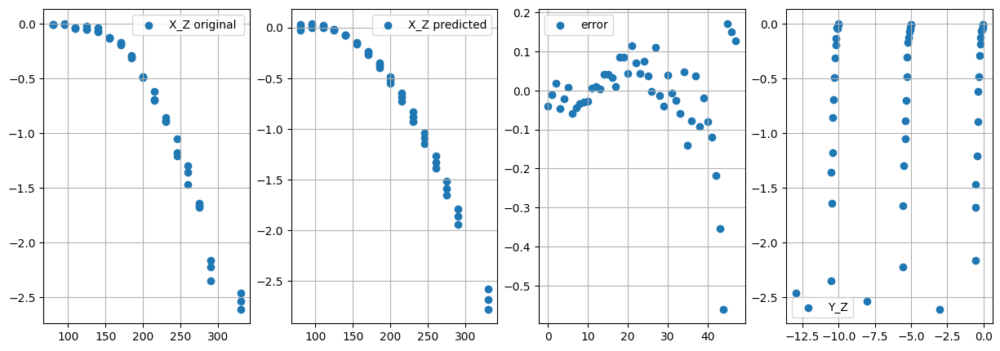

//////// ******************** ///////
Mse is :  0.005370941765797602


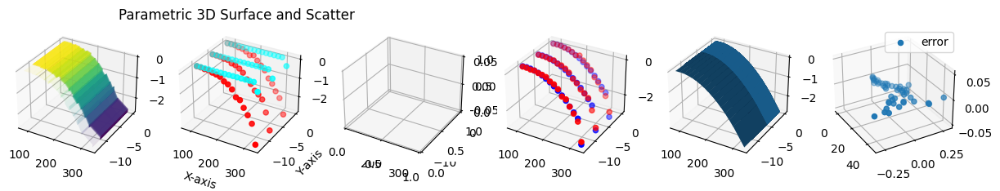

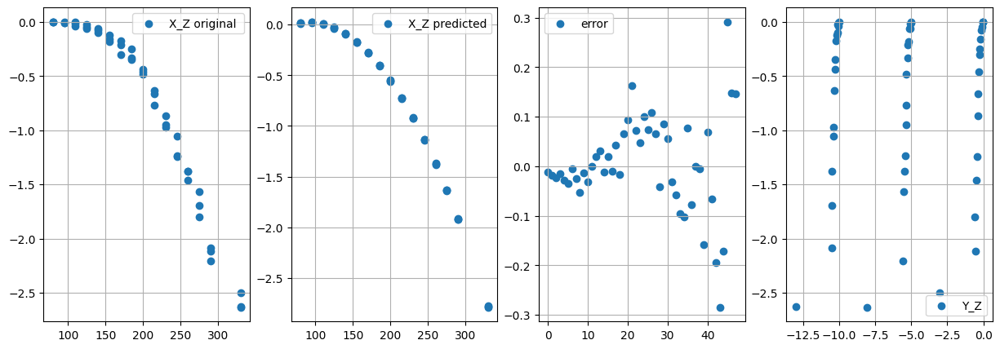

//////// ******************** ///////
Mse is :  0.005346141481270314


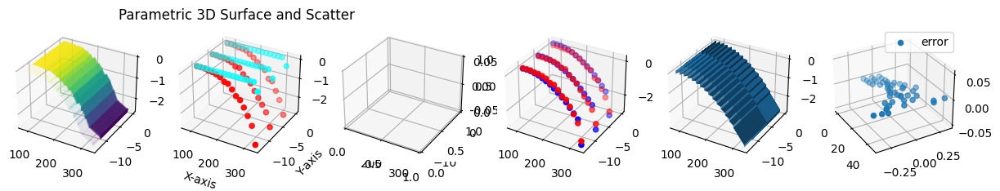

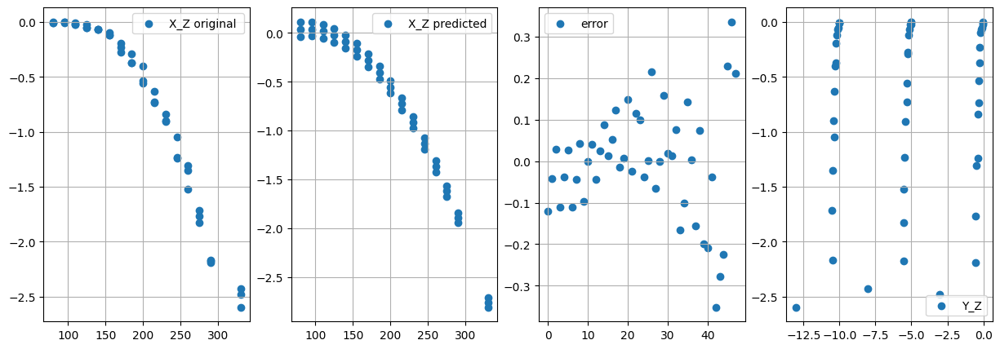

//////// ******************** ///////
Mse is :  0.013391859442319935


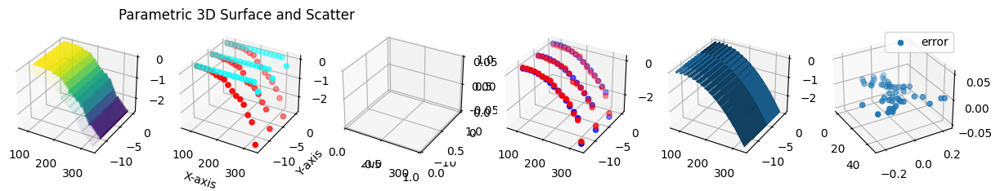

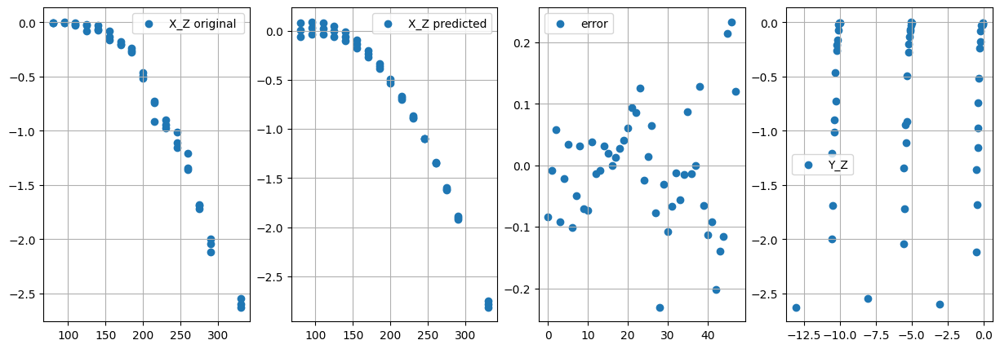

//////// ******************** ///////
Mse is :  0.01961766357933092


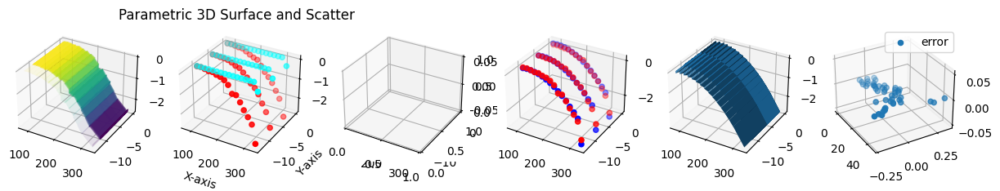

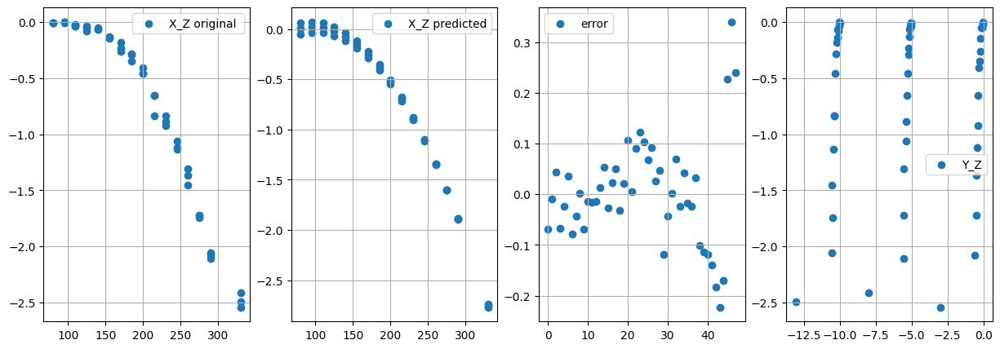

//////// ******************** ///////
Mse is :  0.06991927149158035


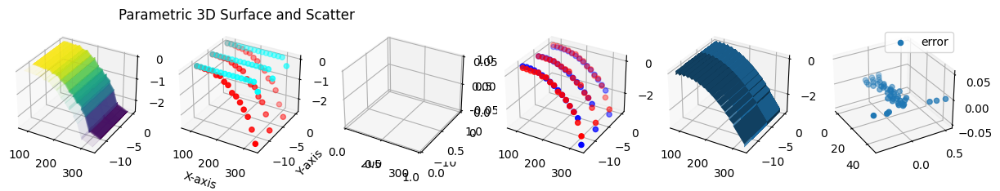

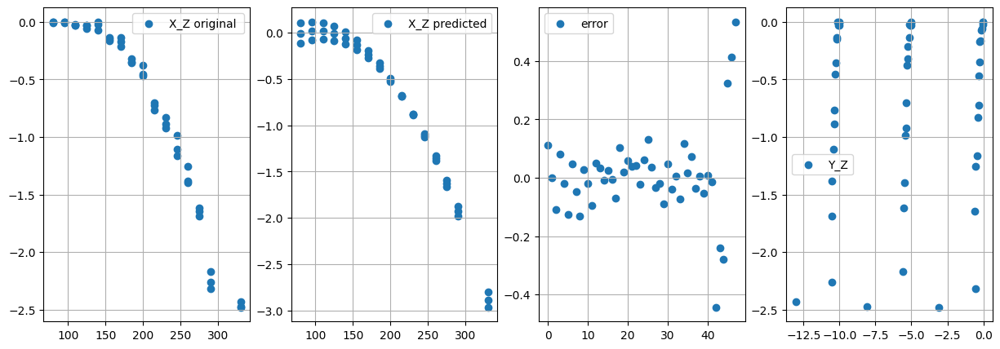

//////// ******************** ///////
Mse is :  0.033980085631656595


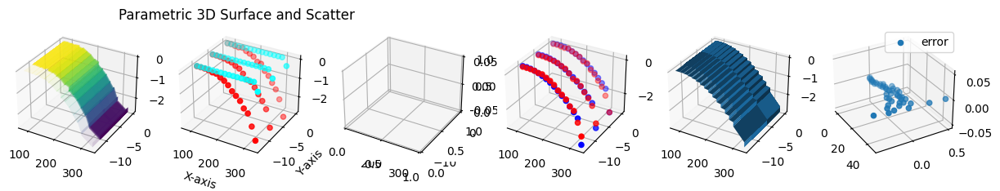

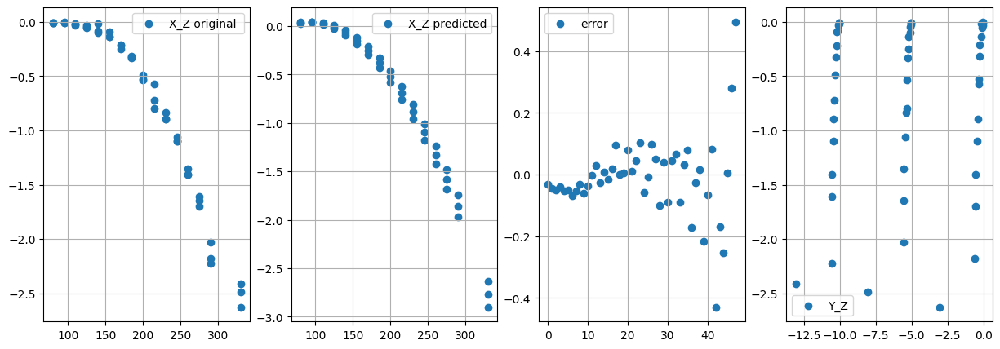

//////// ******************** ///////
Mse is :  0.008782095836291406


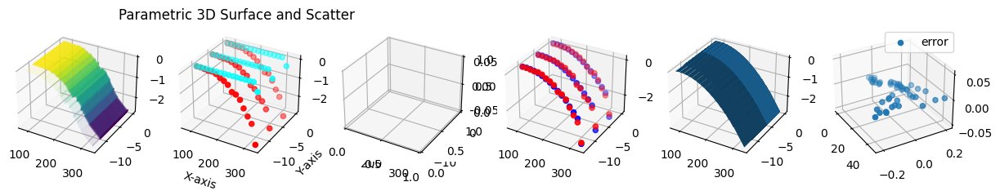

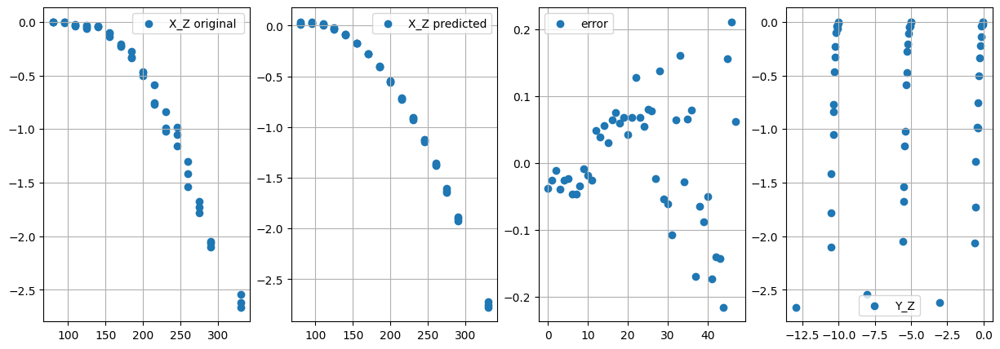

//////// ******************** ///////
Mse is :  0.030826070231106062


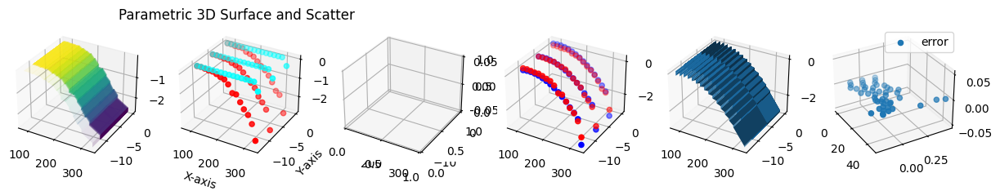

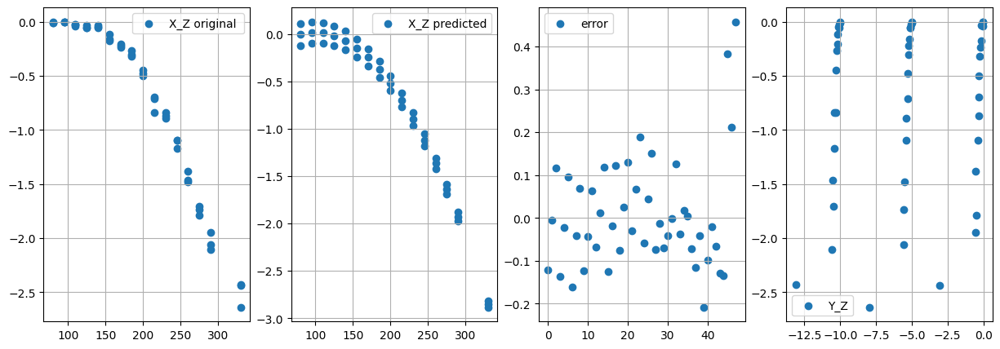

//////// ******************** ///////
Mse is :  0.16440574782284284


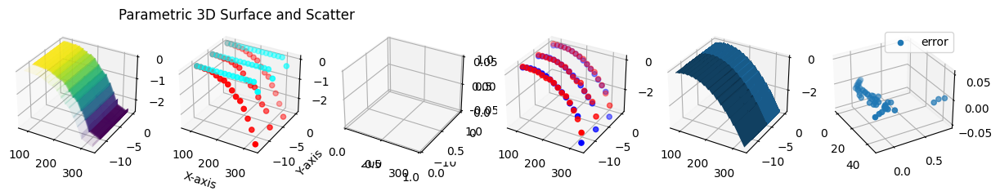

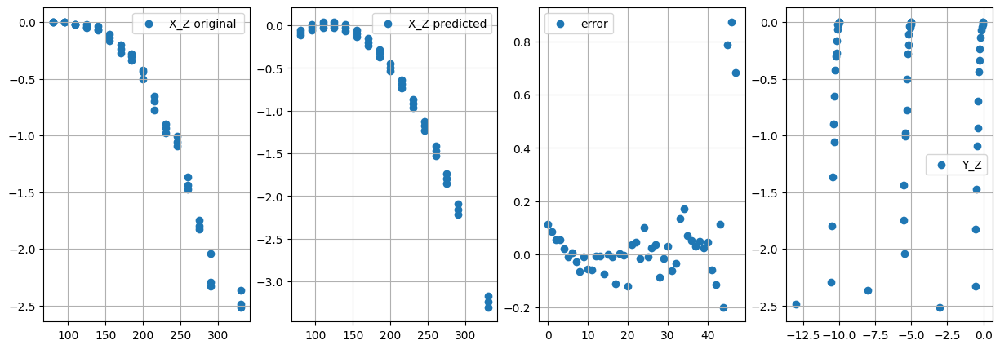

//////// ******************** ///////
Mse is :  0.0125094426445667


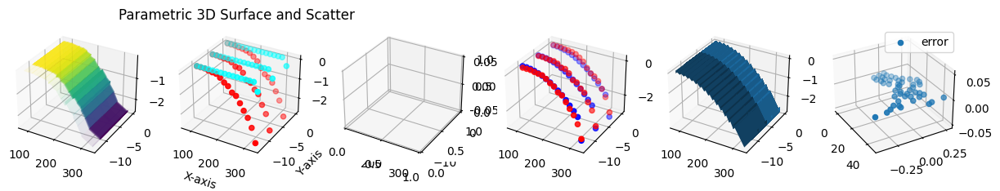

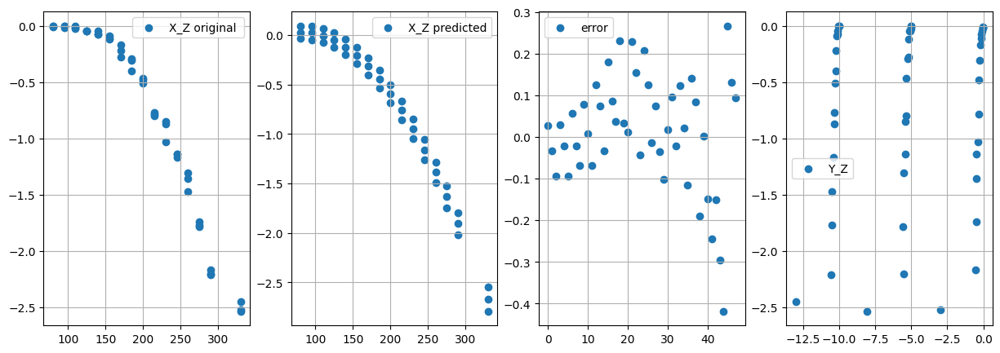

//////// ******************** ///////


In [15]:
params = []
for iteration  in range(100) :
  new_data_simulated_from_table_28_24 = []
  for i in range(table_28_24_blade_1.shape[0]) :
    x_mean = table_28_24_blade_1.iloc[ i , 1 ]
    x_std  = table_28_24_blade_1.iloc[ i , 2 ]
    y_mean = table_28_24_blade_1.iloc[ i , 3 ]
    y_std  = table_28_24_blade_1.iloc[ i , 4 ]
    z_mean = table_28_24_blade_1.iloc[ i , 5 ]
    z_std  = table_28_24_blade_1.iloc[ i , 6 ]

    for element in total_points[i*3 : (i+1)*3 , : ] :
      x_sample = element[0]
      y_sample = element[1]
      z_sample = element[2]

      rng = np.random.default_rng()

      x_added = rng.normal(x_mean, x_std , size=1 )
      x_added = x_added.tolist()[0]
      x_sample += x_added

      y_added = rng.normal(y_mean, y_std , size=1 )
      y_added = y_added.tolist()[0]
      y_sample += y_added

      z_added = rng.normal(z_mean, z_std , size=1 )
      z_added = z_added.tolist()[0]
      z_sample += z_added


      new_data_simulated_from_table_28_24.append([x_sample ,y_sample , z_sample ])

  new_data_simulated_from_table_28_24 = np.array(new_data_simulated_from_table_28_24)
  U1, V1 = np.meshgrid(new_data_simulated_from_table_28_24[ : ,  0 ]  , new_data_simulated_from_table_28_24[ : , 1 ] )
  U, V = np.meshgrid(total_points[ : ,  0 ]  , total_points[ : , 1 ] )


  fig = plt.figure(figsize = (15 , 15 ) )


  ax0 = fig.add_subplot(1 , 6 , 1, projection='3d' )
  ax0.plot_surface(U1 , V1 , new_data_simulated_from_table_28_24[ : ,  2 ].reshape(1 , -1 )  , alpha = 0.1 , cmap="viridis"  )



  ax1 = fig.add_subplot(1 , 6 , 2 , projection='3d' )

  # Plotting the parametric 3D surface
  #ax1.plot_surface(U1 , V1 , new_data_simulated_from_table_28_24[ : ,  2 ].reshape(1 , -1 )  , alpha = 0.1  )
  ax1.scatter3D(new_data_simulated_from_table_28_24[ : ,  0 ], new_data_simulated_from_table_28_24[ : , 1 ] , new_data_simulated_from_table_28_24[ : , 2  ] , color = "red" )
  ax1.scatter3D(total_points[ : ,  0 ], total_points[ : , 1 ] , total_points[ : , 2  ] , color = "aqua" )


  ax = fig.add_subplot(1 , 6 , 3 , projection='3d' )

  # Plotting the parametric 3D surface
  ax.plot_surface(U, V, total_points[ : ,  2 ].reshape(1 , -1 ) , cmap='viridis' )
  ax.scatter3D(total_points[ : ,  0 ], total_points[ : , 1 ] , total_points[ : , 2  ] , color = "aqua" )


  # Customizing the plot
  ax1.set_xlabel('X-axis')
  ax1.set_ylabel('Y-axis')
  ax1.set_zlabel('Z-axis')
  ax1.set_title('Parametric 3D Surface and Scatter ')







  df = pd.DataFrame()
  df['X_'] = new_data_simulated_from_table_28_24[ : ,  0 ]
  df['Y_'] = new_data_simulated_from_table_28_24[ : ,  1 ]
  df['Z_'] = new_data_simulated_from_table_28_24[ : ,  2 ]

  poly = PolynomialFeatures(degree = 2 )
  x_poly = poly.fit_transform(df[['X_' , 'Y_']])
  scaler = StandardScaler()
  df_stander = pd.DataFrame(scaler.fit_transform(x_poly) , columns = ['0' , 'X' , 'Y' , 'x1^2' , 'x1x2' , 'x2^2' , ] )

  df_stander['Z_'] = df['Z_']
  x_train , x_test , z_train , z_test  = train_test_split(df_stander[['0' , 'X' , 'Y' , 'x1^2' , 'x1x2' , 'x2^2' ]] , df_stander["Z_" ])
  model = LinearRegression()
  model.fit(x_train,z_train )

  z_predict = model.predict(x_test )
  print("Mse is : " , mean_squared_error(z_predict ,z_test ) )

  intercept_0 = model.intercept_
  coef1 = model.coef_[0]
  coef2 = model.coef_[1]
  coef3 = model.coef_[2]
  coef4 = model.coef_[3]
  coef5 = model.coef_[4]
  coef6 = model.coef_[5]


  #print(f"Formula : z = {intercept_0}+{b}x+{c}y")

  params.append([intercept_0 ,coef1 , coef2 , coef3 , coef4 , coef5 , coef6  , mean_squared_error(z_predict ,z_test ) ] )

  ax4 = fig.add_subplot(1 , 6 , 4 , projection='3d' )

  # Plotting the parametric 3D surface
  #ax4.plot_surface(U, V, total_points[ : ,  2 ].reshape(1 , -1 ) , cmap='viridis' )
  ax4.scatter3D(df['X_'], df[ 'Y_' ] , df['Z_'] , color = "r" )
  total_new_generate = []
  total_error = []
  for i in range(len(df['X_'])) :
    new_value = intercept_0 + coef1 * df_stander.iloc[i , 0 ] + coef2 * df_stander.iloc[i , 1 ] + coef3 * df_stander.iloc[i , 2 ] + coef4 * df_stander.iloc[i , 3 ] + coef5 * df_stander.iloc[i , 4 ]
    + coef6 * df_stander.iloc[i , 5 ]
    total_new_generate.append(new_value)
    error = df_stander.iloc[ i , -1 ] - new_value
    total_error.append(error)



  ax4.scatter3D(df['X_'], df[ 'Y_' ] , total_new_generate , color = "b" )


  ax5 = fig.add_subplot(1 , 6 , 5 , projection='3d' )
  U5_meshgrid , V5_meshgrid = np.meshgrid(df['X_'], df[ 'Y_' ])
  ax5.plot_surface( U5_meshgrid , V5_meshgrid , np.array(total_new_generate).reshape(1 , -1 ) )

  ax6 = fig.add_subplot(1 , 6 , 6  ,  projection='3d' )
  ax6.scatter(    range(len(df)) , total_error   , label='error' )
  ax6.legend()
  ax6.view_init(30 , -30 )


  fig2 = plt.figure(figsize = (15 , 5 ))
  ax7 = fig2.add_subplot(141 )
  ax7.scatter(df['X_'] , df[ 'Z_' ] , label='X_Z original ' )
  ax7.legend()
  ax7.grid()


  ax8 = fig2.add_subplot(142 )
  ax8.scatter(df['X_'] , total_new_generate, label='X_Z predicted' )
  ax8.legend()
  ax8.grid()

  ax9 = fig2.add_subplot(143 )
  ax9.scatter(range(len(df)) , total_error   , label='error')
  ax9.legend()
  ax9.grid()


  ax10 = fig2.add_subplot(144 )
  ax10.scatter(df['Y_'], df['Z_']   , label='Y_Z' )
  ax10.legend()
  ax10.grid()



  ax11 = fig.add_subplot(1 , 6 , 3 , projection='3d' )

  # Plotting the parametric 3D surface
  ax.plot_surface(U, V, total_points[ : ,  2 ].reshape(1 , -1 ) , cmap='viridis' )
  ax.scatter3D(total_points[ : ,  0 ], total_points[ : , 1 ] , total_points[ : , 2  ] , color = "aqua" )




  plt.show()





  print("//////// ******************** ///////")
total_parameters = pd.DataFrame(params)
total_parameters.columns = ['intercept_' , 'coef0 * 0 ' , 'coef_1 * X' , 'coef_2 * Y' , 'coef_3 * x1^2' , 'coef_4 * x1x2' , 'coef_5 * x2^2'  , 'mse'  ]



In [11]:
df_stander.shape

(48, 11)

In [ ]:
'coef_1 * X' , 'coef_2 * Y' , 'coef_3 * x1^2' , 'coef_4 * x1x2' , 'coef_5 * x2^2'  , 'mse'

In [17]:
intercept_mean  = total_parameters['intercept_'].mean()
intercept__std  = total_parameters['intercept_'].std()

coef0_mean = total_parameters['coef0 * 0 '].mean()
coef0_std  = total_parameters['coef0 * 0 '].std()

coef_1_mean = total_parameters['coef_1 * X'].mean()
coef_1_std  = total_parameters['coef_1 * X'].std()

coef_2_mean = total_parameters['coef_2 * Y' ].mean()
coef_2_std  = total_parameters['coef_2 * Y' ].std()


coef_3_mean = total_parameters['coef_3 * x1^2'].mean()
coef_3_std  = total_parameters['coef_3 * x1^2'].std()

coef_4_mean = total_parameters['coef_4 * x1x2' ].mean()
coef_4_std  = total_parameters['coef_4 * x1x2' ].std()

coef_5_mean = total_parameters['coef_5 * x2^2'].mean()
coef_5_std  = total_parameters['coef_5 * x2^2'].std()


In [ ]:
total_parameters.columns = ['intercept_' , 'coef0 * 0 ' , 'coef_1 * X' , 'coef_2 * Y' , 'coef_3 * x1^2' , 'coef_4 * x1x2' , 'coef_5 * x2^2'  , 'mse'  ]


In [ ]:
fig = plt.figure(figsize=(20 , 5))
ax0 = fig.add_subplot(131 )
ax0.plot(total_parameters.a , label='intercept = a ' , marker ='*' , mec='purple')
ax0.hlines(a_mean , xmin = 0 , xmax = 100 )
ax0.hlines(a_mean+3*a_std , xmin = 0 , xmax = 100 , label = 'UCL a' , color ='r' , ls='--')
ax0.hlines(a_mean-3*a_std , xmin = 0 , xmax = 100 , label = 'LCL a' , color ='r' , ls='--')


plt.grid()
plt.legend()

ax1 = fig.add_subplot(132 )
ax1.plot(total_parameters.b , label='coef1 b ' , marker ='*' , mec='purple')
ax1.hlines(b_mean , xmin = 0 , xmax = 100 )
ax1.hlines(b_mean+3*b_std , xmin = 0 , xmax = 100 , label = 'UCL b' , color ='r' , ls='--')
ax1.hlines(b_mean-3*b_std , xmin = 0 , xmax = 100 , label = 'LCL b' , color ='r' , ls='--')
plt.grid()
plt.legend()

ax2 = fig.add_subplot(133 )
ax2.plot(total_parameters.c , label='coef2 c ' , marker ='*' , mec='purple')
ax2.hlines(c_mean , xmin = 0 , xmax = 100 )
ax2.hlines(c_mean+3*c_std , xmin = 0 , xmax = 100 , label = 'UCL c' , color ='r' , ls='--')
ax2.hlines(c_mean-3*c_std , xmin = 0 , xmax = 100 , label = 'LCL c' , color ='r' , ls='--')



plt.grid()
plt.legend()
plt.show()